# Importing Libraries

In [93]:
import numpy as np
import seaborn as sns
import pandas as pd
import missingno as msno
import sweetviz as sw
import dtale
import scipy.stats as stats

In [94]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 

import warnings
warnings.filterwarnings('ignore')

from sklearn.model_selection import train_test_split
import statsmodels.formula.api as SM
import sklearn.metrics as metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_auc_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from category_encoders.hashing import HashingEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Read Data

In [95]:
df=pd.read_csv('Telecom_Sampled.csv')

In [96]:
df_org=df.copy()

In [97]:
df.head()

,mou_Mean,totmrc_Mean,rev_Range,mou_Range,change_mou,drop_blk_Mean,drop_vce_Range,owylis_vce_Range,mou_opkv_Range,months,totcalls,income,eqpdays,custcare_Mean,callwait_Mean,iwylis_vce_Mean,callwait_Range,ccrndmou_Range,adjqty,ovrrev_Mean,rev_Mean,ovrmou_Mean,comp_vce_Mean,plcd_vce_Mean,avg3mou,avgmou,avg3qty,avgqty,avg6mou,avg6qty,crclscod,asl_flag,prizm_social_one,area,refurb_new,hnd_webcap,marital,ethnic,age1,age2,models,hnd_price,actvsubs,uniqsubs,forgntvl,dwlltype,dwllsize,mailordr,occu1,opk_dat_Mean,mtrcycle,numbcars,retdays,truck,wrkwoman,roam_Mean,recv_sms_Mean,blck_dat_Mean,mou_pead_Mean,churn,solflag,proptype,mailresp,cartype,car_buy,children,csa,da_Mean,da_Range,datovr_Mean,datovr_Range,div_type,drop_dat_Mean,drop_vce_Mean,adjmou,totrev,adjrev,avgrev,Customer_ID,comp_dat_Mean,plcd_dat_Mean
0,190.25,63.9400,26.00,43.0,-11.25,4.666667,8,20,28.44,14,1104,9.0,403,0.000000,0.666667,10.333333,2,0,1104,2.050,53.4900,5.50,59.333333,73.333333,194,182.77,91,84.92,211.0,99.0,AA,N,T,ATLANTIC SOUTH AREA,N,WCMB,M,N,36.0,0.0,1,199.98999,2,2,0.0,S,A,B,A,0.0,0.0,NaN,NaN,0.0,Y,0.0,0.0,0.0,0.000000,0,NaN,A,R,NaN,UNKNOWN,Y,AIRCOL803,0.0000,0.00,0.0000,0.00,NaN,0.0,3.666667,2376.0,519.07,489.08,37.62,1064525,0.000000,0.000000
1,443.00,39.9900,5.10,199.0,-78.00,4.333333,5,33,72.46,13,2237,9.0,404,1.333333,0.000000,16.333333,0,14,2230,8.840,34.3575,25.00,87.000000,104.333333,469,463.75,188,185.83,467.0,166.0,EA,N,U,LOS ANGELES AREA,N,WCMB,U,S,0.0,0.0,1,149.98999,1,1,0.0,NaN,NaN,NaN,NaN,0.0,0.0,1.0,NaN,0.0,NaN,0.0,0.0,0.0,0.883333,0,NaN,NaN,NaN,NaN,New,NaN,LAXCUL310,0.2475,0.99,0.8775,3.51,NaN,0.0,3.000000,5565.0,598.53,538.55,44.88,1048538,0.333333,0.333333
2,400.50,44.9900,13.88,172.0,-67.50,2.000000,1,7,93.60,29,3276,6.0,213,1.000000,0.000000,0.000000,0,28,3269,4.725,40.5350,13.50,124.666667,153.000000,423,291.33,134,121.07,333.0,118.0,C,N,C,MIDWEST AREA,N,WCMB,M,N,32.0,30.0,2,99.98999,1,1,0.0,S,A,B,NaN,0.0,0.0,1.0,NaN,0.0,NaN,0.0,0.0,0.0,0.000000,0,NaN,NaN,R,E,New,Y,STLSTL314,0.4950,1.98,0.0000,0.00,NaN,0.0,0.333333,7866.0,1616.71,1586.36,58.75,1010139,0.000000,0.333333
3,53.50,34.6675,18.56,78.0,12.50,1.333333,2,0,4.70,25,1932,8.0,757,4.666667,0.000000,0.000000,0,76,1924,9.300,38.7400,23.25,32.333333,43.000000,49,243.50,25,80.17,244.0,95.0,EA,N,U,LOS ANGELES AREA,N,WC,U,U,34.0,38.0,1,29.98999,1,1,0.0,NaN,NaN,NaN,NaN,0.0,0.0,1.0,NaN,0.0,NaN,0.0,0.0,0.0,0.000000,0,NaN,NaN,NaN,NaN,New,NaN,LAXANA714,0.0000,0.00,0.0000,0.00,LDD,0.0,0.666667,5844.0,1682.44,1647.63,68.65,1014496,0.000000,0.000000
4,37.00,21.0425,35.79,74.0,-33.00,5.666667,1,4,36.60,33,652,5.0,983,0.333333,0.000000,0.000000,0,4,636,0.000,21.0425,0.00,10.666667,18.000000,48,50.74,12,20.52,43.0,16.0,G,N,U,DC/MARYLAND/VIRGINIA AREA,N,NaN,B,N,78.0,0.0,1,29.98999,1,1,0.0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.000000,0,NaN,NaN,NaN,NaN,UNKNOWN,NaN,NCRGRB757,0.0000,0.00,0.0000,0.00,NaN,0.0,1.333333,1573.0,967.59,916.61,29.57,1012053,0.000000,0.000000


In [98]:
df.shape

(26518, 81)

In [99]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

# EDA

## 5 Point Summary

In [100]:
df.describe(include='all')

,mou_Mean,totmrc_Mean,rev_Range,mou_Range,change_mou,drop_blk_Mean,drop_vce_Range,owylis_vce_Range,mou_opkv_Range,months,totcalls,income,eqpdays,custcare_Mean,callwait_Mean,iwylis_vce_Mean,callwait_Range,ccrndmou_Range,adjqty,ovrrev_Mean,rev_Mean,ovrmou_Mean,comp_vce_Mean,plcd_vce_Mean,avg3mou,avgmou,avg3qty,avgqty,avg6mou,avg6qty,crclscod,asl_flag,prizm_social_one,area,refurb_new,hnd_webcap,marital,ethnic,age1,age2,models,hnd_price,actvsubs,uniqsubs,forgntvl,dwlltype,dwllsize,mailordr,occu1,opk_dat_Mean,mtrcycle,numbcars,retdays,truck,wrkwoman,roam_Mean,recv_sms_Mean,blck_dat_Mean,mou_pead_Mean,churn,solflag,proptype,mailresp,cartype,car_buy,children,csa,da_Mean,da_Range,datovr_Mean,datovr_Range,div_type,drop_dat_Mean,drop_vce_Mean,adjmou,totrev,adjrev,avgrev,Customer_ID,comp_dat_Mean,plcd_dat_Mean
count,26460.000000,26460.000000,26460.000000,26460.000000,26357.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,19821.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,26460.000000,26460.000000,26460.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,25704.000000,25704.000000,26518,26518,24637,26513,26518,24136,26050,26050,26050.000000,26050.000000,26518.000000,26264.000000,26518.000000,26518.000000,26050.000000,18137,16428,9508,7030,26518.000000,26050.000000,13559.000000,866.000000,26050.000000,3272,26460.000000,26518.000000,26518.000000,26518.000000,26518.000000,515,7531,9896,8563,26050,8956,26513,26460.000000,26460.000000,26460.000000,26460.000000,5017,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,26518.000000,2.651800e+04,26518.000000,26518.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49,2,5,19,2,3,5,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,15,1,21,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,2,6,1,7,2,2,694,NaN,NaN,NaN,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,AA,N,S,NEW YORK CITY AREA,N,WCMB,U,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,S,A,B,1,NaN,NaN,NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,N,A,R,B,UNKNOWN,Y,NYCBRO917,NaN,NaN,NaN,NaN,LDD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9602,22535,8475,3055,22863,20660,9821,8912,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12968,12521,9508,2723,NaN,NaN,NaN,NaN,NaN,3272,NaN,NaN,NaN,NaN,NaN,509,6753,9896,2012,14999,6251,918,NaN,NaN,NaN,NaN,4260,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,533.578283,47.189057,44.132108,378.747600,-10.210774,10.220366,5.519534,15.904895,117.415913,18.693114,2936.164228,5.772413,376.450072,1.903424,1.892689,8.306936,1.923938,7.453315,2895.653971,13.317581,59.357292,40.480223,112.586935,149.803781,538.477977,493.945391,185.868580,177.225857,527.020347,183.764278,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.162994,21.061843,1.569462,104.950393,1.349348,1.519798,0.058004,NaN,NaN,NaN,NaN,0.431669,0.013666,1.562136,233.841801,0.187447,NaN,1.181131,0.037333,0.021042,0.739179,0.239988,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.903431,1.638027,0.254370,0.707346,NaN,0.039395,6.083666,7707.226798,1037.702327,965.302763,58.374883,1.050532e+06,0.828393,0.916975
std,541.184126,24.264305,71.822912,428.889022,255.202308,15.500170,8.827681,23.611921,181.438026,9.736302,4006.455522,2.188060,251.967184,5.488562,5.754285,16.669723,4.637013,18.445158,3971.453473,30.232221,44.649536,98.163743,121.065609,162.082729,549.295120,451.311277,198.642909,174.079887,514.239338,189.692189,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,22.133762,24.020940,0.910224,60.319106,0.627512,0.841855,0.233755,NaN,NaN,NaN,NaN,4.407282,0.116102,0.627785,218.240487,0.390278,NaN,7.484176,1.025214,0.878617,7.292476,0.427084,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.140022,2.864080,2.536523,6.343231,NaN,0.525410,9.095215,9060.873112,881.6

In [101]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26518 entries, 0 to 26517
Data columns (total 81 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mou_Mean          26460 non-null  float64
 1   totmrc_Mean       26460 non-null  float64
 2   rev_Range         26460 non-null  float64
 3   mou_Range         26460 non-null  float64
 4   change_mou        26357 non-null  float64
 5   drop_blk_Mean     26518 non-null  float64
 6   drop_vce_Range    26518 non-null  int64  
 7   owylis_vce_Range  26518 non-null  int64  
 8   mou_opkv_Range    26518 non-null  float64
 9   months            26518 non-null  int64  
 10  totcalls          26518 non-null  int64  
 11  income            19821 non-null  float64
 12  eqpdays           26518 non-null  int64  
 13  custcare_Mean     26518 non-null  float64
 14  callwait_Mean     26518 non-null  float64
 15  iwylis_vce_Mean   26518 non-null  float64
 16  callwait_Range    26518 non-null  int64 

In [102]:
df=df.set_index('Customer_ID')

In [103]:
df.shape

(26518, 80)

## Univariate Analysis

In [14]:
fig, axs = plt.subplots(27, 3,figsize=(50,350))
j=0
k=0
for i in df.columns:
    if df[i].dtype == 'object':
        ax=sns.countplot(df[i],ax=axs[j,k])
        #ax=sns.countplot(df_train[i].value_counts().index,df[i].value_counts().values,ax=axs[j,k])
        ax.set_title(i)
        ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
        
        #sns.set(font_scale=2,style='dark')
        #sns.set_context('poster')
    elif df[i].dtype != 'object':
        try:
            sns.distplot(df[i],ax=axs[j,k]).set_title(i,y=1)
        except RuntimeError as re:
            if str(re).startswith("Selected KDE bandwidth is 0. Cannot estiamte density."):
                sns.distplot(df[i],ax=axs[j,k],kde_kws={'bw': 0.1}).set_title(i,y=1)
            else:
                raise re
        axs[j,k].set_xlabel('')
    k=k+1
    if k==3:
        k=0
        j=j+1
fig.tight_layout()
fig.savefig('overall.jpg')
plt.show()

## BiVariate Analysis

In [15]:
cat_cols_temp=['income', 'crclscod', 'asl_flag', 'prizm_social_one', 'area', 'refurb_new', 'hnd_webcap', 'marital', 'ethnic', 
          'age1', 'age2', 'models', 'hnd_price', 'actvsubs', 'uniqsubs', 'forgntvl', 'dwlltype', 'dwllsize', 'mailordr', 
          'occu1', 'mtrcycle', 'numbcars', 'truck', 'wrkwoman', 'churn', 'solflag', 'proptype', 'mailresp', 'cartype',
          'car_buy', 'children', 'csa', 'div_type']

In [16]:
cont_cols_temp=['mou_Mean', 'totmrc_Mean', 'rev_Range', 'mou_Range', 'change_mou', 'drop_blk_Mean', 'drop_vce_Range',
           'owylis_vce_Range', 'mou_opkv_Range', 'months', 'totcalls', 'eqpdays', 'custcare_Mean', 'callwait_Mean',
           'iwylis_vce_Mean', 'callwait_Range', 'ccrndmou_Range', 'adjqty', 'ovrrev_Mean', 'rev_Mean', 'ovrmou_Mean', 
           'comp_vce_Mean', 'plcd_vce_Mean', 'avg3mou', 'avgmou', 'avg3qty', 'avgqty', 'avg6mou', 'avg6qty', 'opk_dat_Mean',
           'retdays', 'roam_Mean', 'recv_sms_Mean', 'blck_dat_Mean', 'mou_pead_Mean', 'da_Mean', 'da_Range', 'datovr_Mean',
           'datovr_Range', 'drop_dat_Mean', 'drop_vce_Mean', 'adjmou', 'totrev', 'adjrev', 'avgrev', 'comp_dat_Mean',
           'plcd_dat_Mean']

In [18]:
df_cat_temp=df[cat_cols_temp]

In [19]:
df_cont_temp=df[cont_cols_temp]

In [20]:
df_cat_temp[cat_cols_temp] = df_cat_temp[cat_cols_temp].astype('object')

### Categorical Variables

In [24]:
def bivariate_analyze_cat(df,df_cat,dep_var):
    for col in df_cat:
        if col == dep_var:
            continue
        else:
            print("------------------------------------------------ Variable Name: "+col+" ------------------------------------------------" )
            print("Unique Values:")
            print(df[col].unique())
            plt.figure(figsize=(10,10))
            plt.figure(figsize=(7,7))
            ax=sns.countplot(df[col],order= df[col].value_counts().index)
            ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
            plt.show()
            plt.figure(figsize=(10,10))
            plt.figure(figsize=(7,7))
            ax=sns.countplot(df[col],hue=df[dep_var],order= df[col].value_counts().index)
            ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
            plt.show()
            print('Top categories impacting churn')
            print(df[[dep_var]].groupby(df[col]).count().sort_values(by=dep_var,ascending=False).head())

------------------------------------------------ Variable Name: income ------------------------------------------------
Unique Values:
[ 9.  6.  8.  5. nan  3.  7.  2.  1.  4.]


<Figure size 720x720 with 0 Axes>

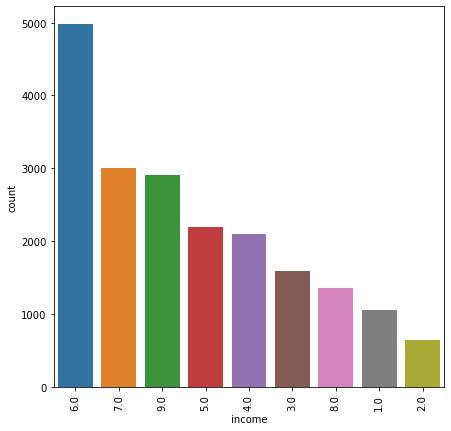

<Figure size 720x720 with 0 Axes>

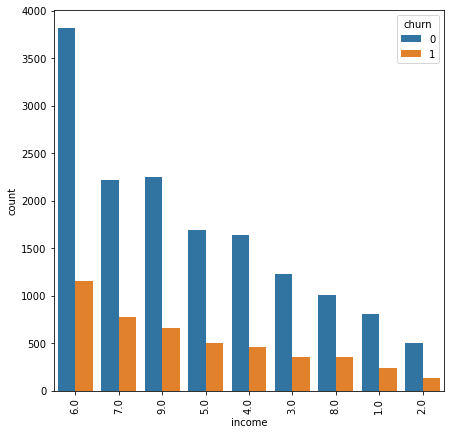

Top categories impacting churn
        churn
income       
6.0      4976
7.0      3003
9.0      2907
5.0      2199
4.0      2103
------------------------------------------------ Variable Name: crclscod ------------------------------------------------
Unique Values:
['AA' 'EA' 'C' 'G' 'CA' 'E4' 'E' 'B' 'BA' 'O' 'A' 'DA' 'U' 'ZA' 'D4' 'A2'
 'D5' 'C2' 'GA' 'Z4' 'JF' 'IF' 'ZY' 'GY' 'Z' 'CC' 'I' 'B2' 'EM' 'E2' 'K'
 'M' 'EC' 'V1' 'CY' 'D' 'U1' 'Z5' 'C5' 'W' 'J' 'H' 'EF' 'Y' 'TP' 'A3' 'Z2'
 'Z1' 'D2']


<Figure size 720x720 with 0 Axes>

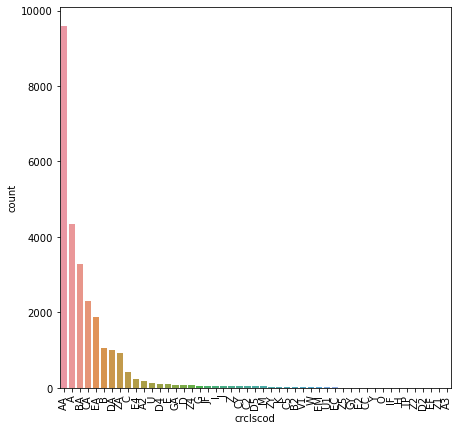

<Figure size 720x720 with 0 Axes>

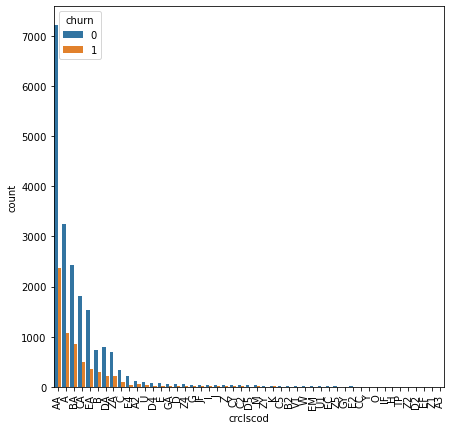

Top categories impacting churn
          churn
crclscod       
AA         9602
A          4338
BA         3283
CA         2298
EA         1889
------------------------------------------------ Variable Name: asl_flag ------------------------------------------------
Unique Values:
['N' 'Y']


<Figure size 720x720 with 0 Axes>

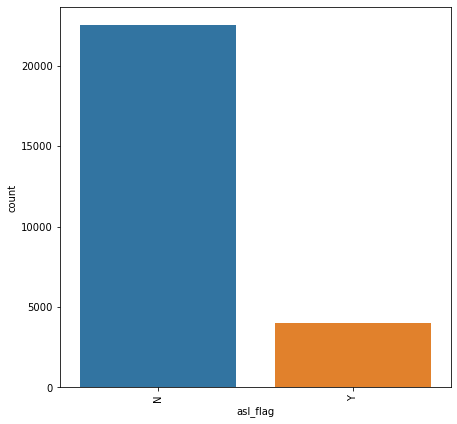

<Figure size 720x720 with 0 Axes>

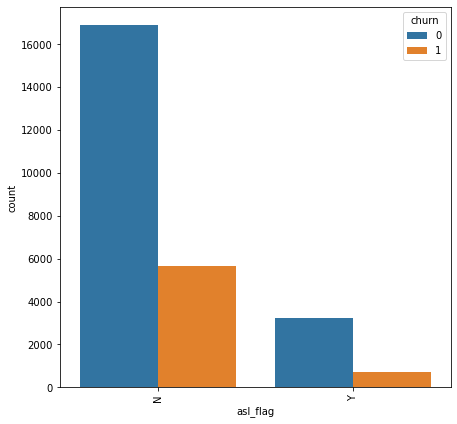

Top categories impacting churn
          churn
asl_flag       
N         22535
Y          3983
------------------------------------------------ Variable Name: prizm_social_one ------------------------------------------------
Unique Values:
['T' 'U' 'C' 'S' 'R' nan]


<Figure size 720x720 with 0 Axes>

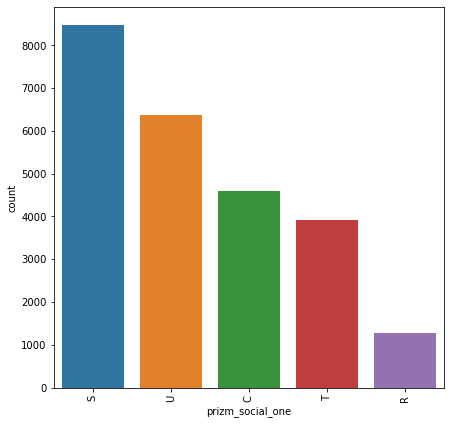

<Figure size 720x720 with 0 Axes>

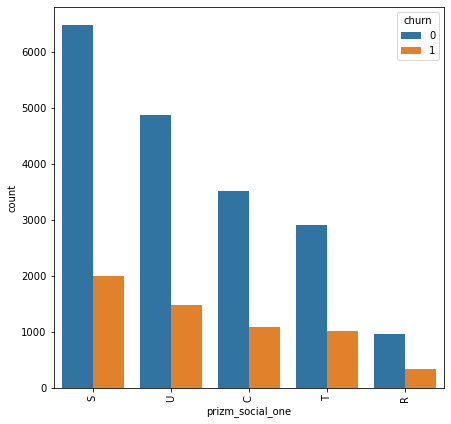

Top categories impacting churn
                  churn
prizm_social_one       
S                  8475
U                  6368
C                  4594
T                  3921
R                  1279
------------------------------------------------ Variable Name: area ------------------------------------------------
Unique Values:
['ATLANTIC SOUTH AREA' 'LOS ANGELES AREA' 'MIDWEST AREA'
 'DC/MARYLAND/VIRGINIA AREA' 'NEW YORK CITY AREA' 'DALLAS AREA'
 'NORTHWEST/ROCKY MOUNTAIN AREA' 'NEW ENGLAND AREA' 'SOUTHWEST AREA'
 'CHICAGO AREA' 'OHIO AREA' 'NORTH FLORIDA AREA' 'CALIFORNIA NORTH AREA'
 'HOUSTON AREA' 'SOUTH FLORIDA AREA' 'CENTRAL/SOUTH TEXAS AREA'
 'TENNESSEE AREA' 'GREAT LAKES AREA' 'PHILADELPHIA AREA' nan]


<Figure size 720x720 with 0 Axes>

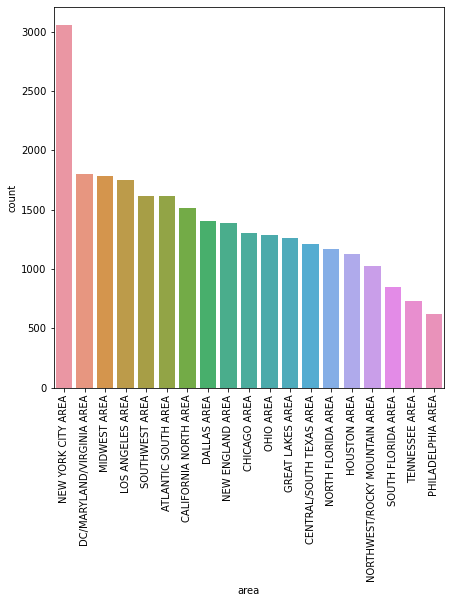

<Figure size 720x720 with 0 Axes>

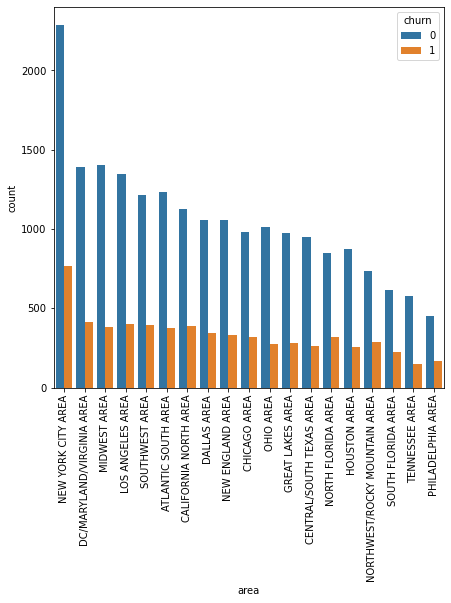

Top categories impacting churn
                           churn
area                            
NEW YORK CITY AREA          3055
DC/MARYLAND/VIRGINIA AREA   1805
MIDWEST AREA                1782
LOS ANGELES AREA            1750
SOUTHWEST AREA              1613
------------------------------------------------ Variable Name: refurb_new ------------------------------------------------
Unique Values:
['N' 'R']


<Figure size 720x720 with 0 Axes>

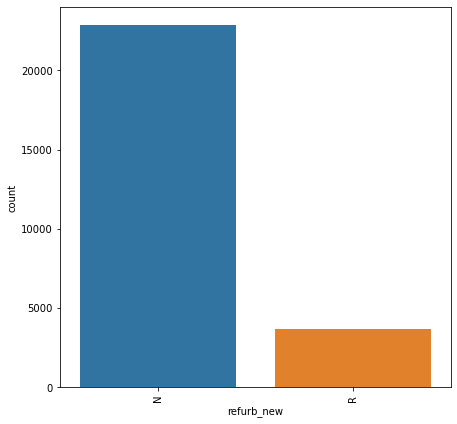

<Figure size 720x720 with 0 Axes>

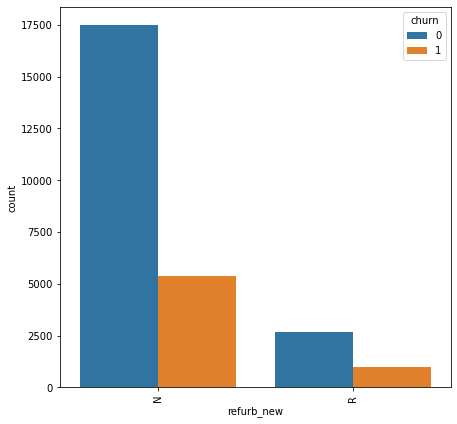

Top categories impacting churn
            churn
refurb_new       
N           22863
R            3655
------------------------------------------------ Variable Name: hnd_webcap ------------------------------------------------
Unique Values:
['WCMB' 'WC' nan 'UNKW']


<Figure size 720x720 with 0 Axes>

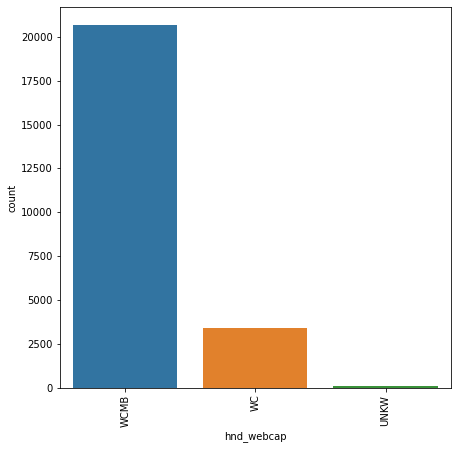

<Figure size 720x720 with 0 Axes>

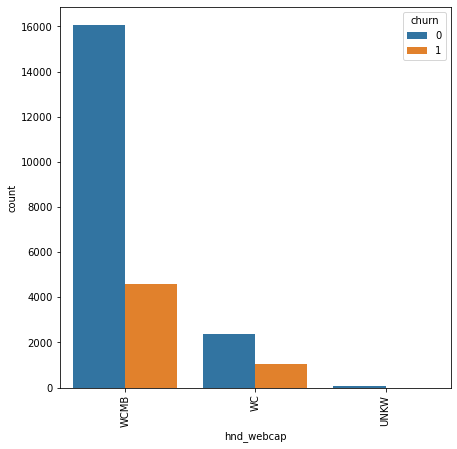

Top categories impacting churn
            churn
hnd_webcap       
WCMB        20660
WC           3408
UNKW           68
------------------------------------------------ Variable Name: marital ------------------------------------------------
Unique Values:
['M' 'U' 'B' 'S' 'A' nan]


<Figure size 720x720 with 0 Axes>

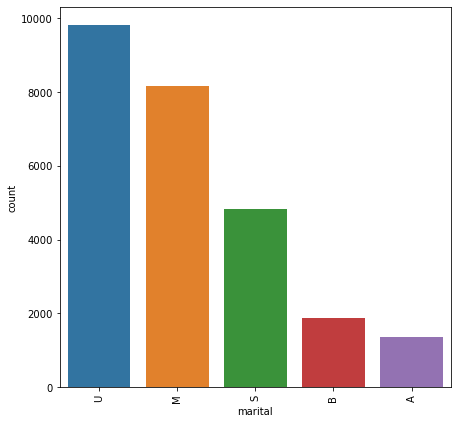

<Figure size 720x720 with 0 Axes>

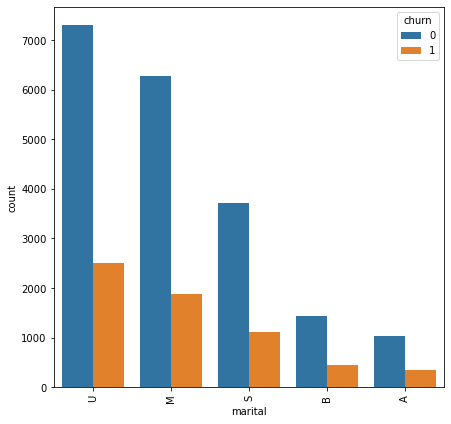

Top categories impacting churn
         churn
marital       
U         9821
M         8159
S         4829
B         1880
A         1361
------------------------------------------------ Variable Name: ethnic ------------------------------------------------
Unique Values:
['N' 'S' 'U' 'H' 'R' 'G' 'O' 'D' 'Z' 'F' 'I' nan 'J' 'B' 'P' 'M' 'X' 'C']


<Figure size 720x720 with 0 Axes>

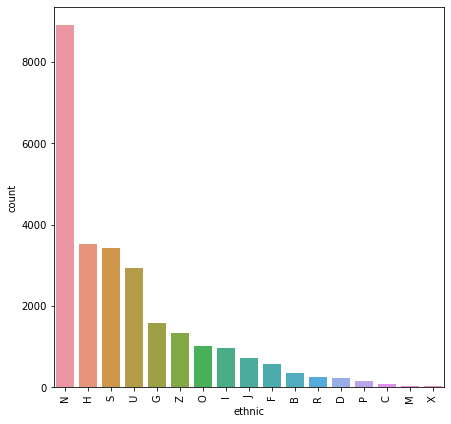

<Figure size 720x720 with 0 Axes>

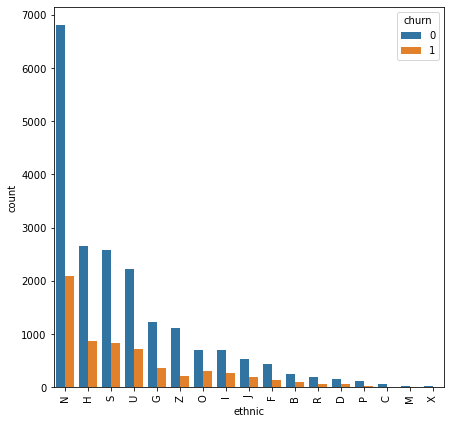

Top categories impacting churn
        churn
ethnic       
N        8912
H        3512
S        3417
U        2940
G        1584
------------------------------------------------ Variable Name: age1 ------------------------------------------------
Unique Values:
[36.  0. 32. 34. 78. 50. 40. 54. 28. 22. 46. 24. 56. 26. 42. 30. 60. 58.
 44. 38. 48. 70. 52. nan 64. 72. 66. 18. 88. 68. 80. 62. 76. 82. 20. 86.
 84. 74. 94. 90. 92.]


<Figure size 720x720 with 0 Axes>

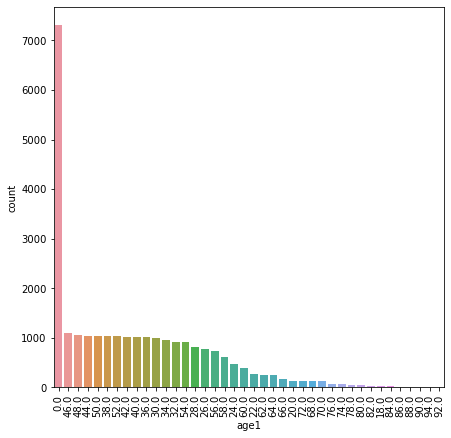

<Figure size 720x720 with 0 Axes>

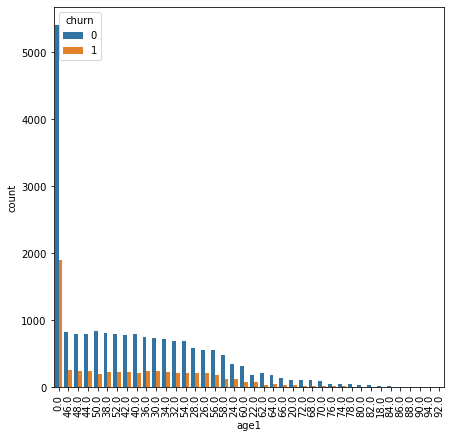

Top categories impacting churn
      churn
age1       
0.0    7309
46.0   1093
48.0   1050
50.0   1037
44.0   1037
------------------------------------------------ Variable Name: age2 ------------------------------------------------
Unique Values:
[ 0. 30. 38. 48. 42. 52. 72. 54. 46. 56. 32. 28. 24. 44. 20. 50. 26. 40.
 22. 60. nan 66. 18. 36. 70. 86. 34. 58. 64. 78. 82. 68. 62. 76. 74. 90.
 80. 94. 84. 92. 98. 88. 96. 99.]


<Figure size 720x720 with 0 Axes>

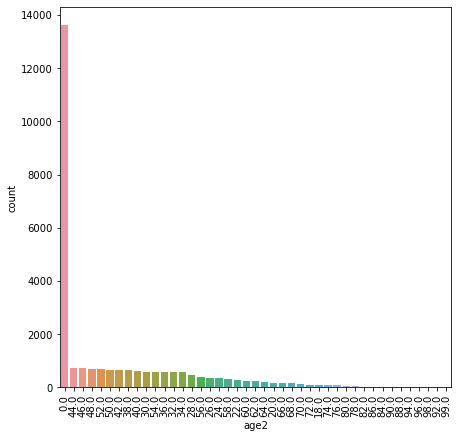

<Figure size 720x720 with 0 Axes>

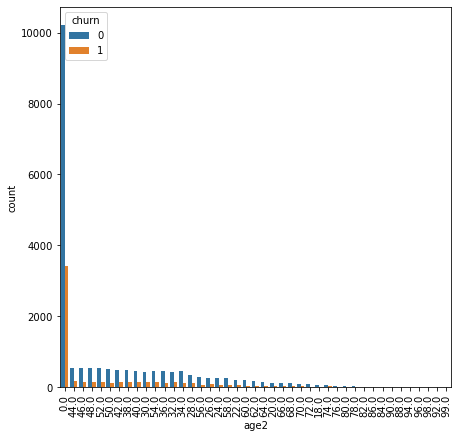

Top categories impacting churn
      churn
age2       
0.0   13627
44.0    727
46.0    721
48.0    711
52.0    683
------------------------------------------------ Variable Name: models ------------------------------------------------
Unique Values:
[ 1  2  4  3  5  6  8  7 15  9 10]


<Figure size 720x720 with 0 Axes>

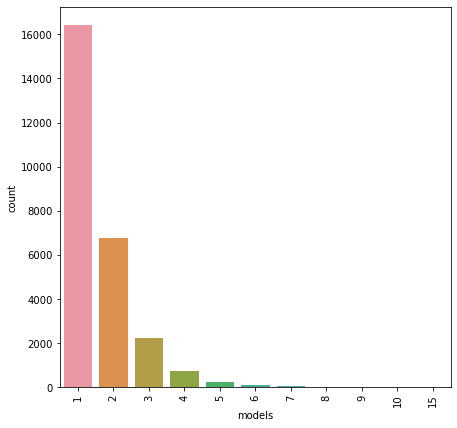

<Figure size 720x720 with 0 Axes>

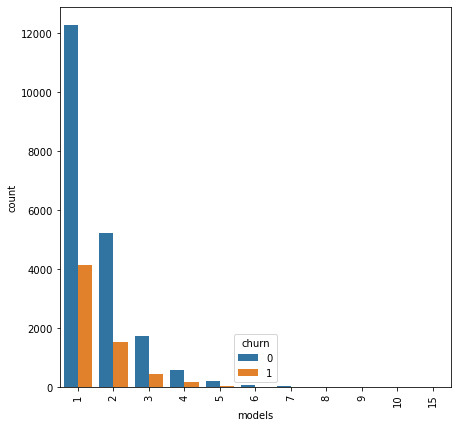

Top categories impacting churn
        churn
models       
1       16441
2        6765
3        2203
4         734
5         238
------------------------------------------------ Variable Name: hnd_price ------------------------------------------------
Unique Values:
[199.9899902  149.9899902   99.98999023  29.98999023  79.98999023
  59.98999023 129.9899902    9.98999786 299.9899902  249.9899902
          nan 179.9899902   39.98999023 499.9899902  399.9899902
 239.9899902  119.9899902 ]


<Figure size 720x720 with 0 Axes>

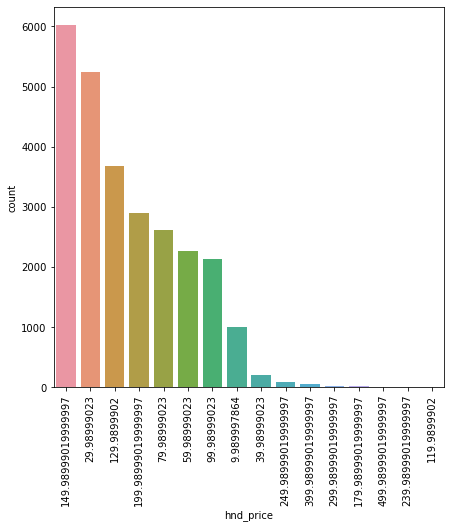

<Figure size 720x720 with 0 Axes>

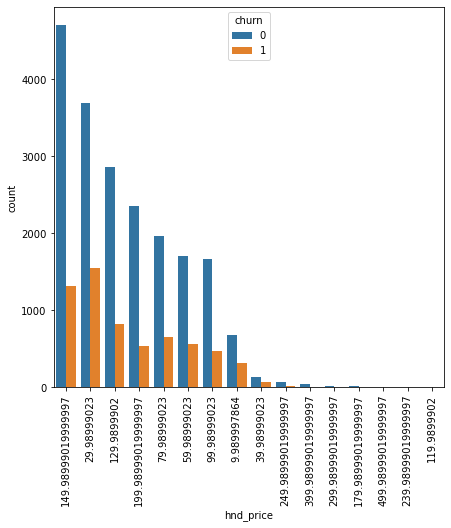

Top categories impacting churn
           churn
hnd_price       
149.98999   6025
29.98999    5244
129.98999   3684
199.98999   2893
79.98999    2616
------------------------------------------------ Variable Name: actvsubs ------------------------------------------------
Unique Values:
[ 2  1  3  4  5  0  8 11  6  7]


<Figure size 720x720 with 0 Axes>

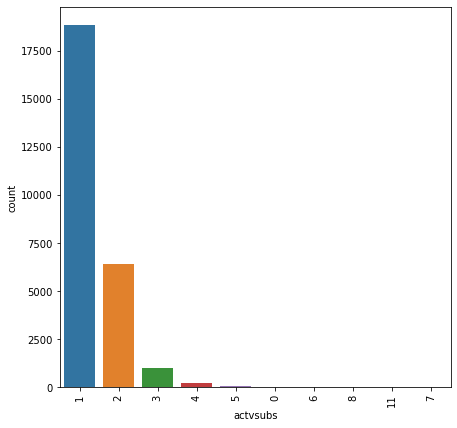

<Figure size 720x720 with 0 Axes>

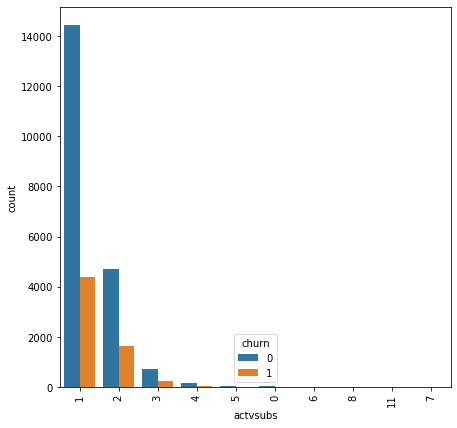

Top categories impacting churn
          churn
actvsubs       
1         18848
2          6379
3           977
4           204
5            73
------------------------------------------------ Variable Name: uniqsubs ------------------------------------------------
Unique Values:
[ 2  1  3  5  4  6  7  8 11  9 12]


<Figure size 720x720 with 0 Axes>

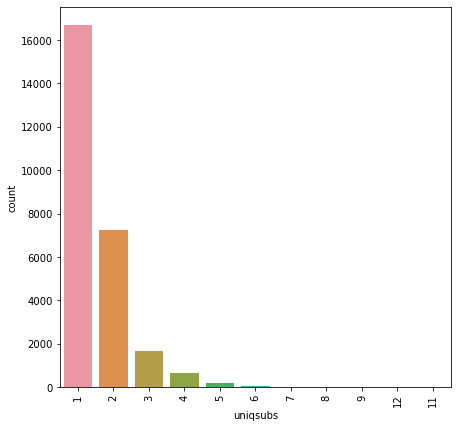

<Figure size 720x720 with 0 Axes>

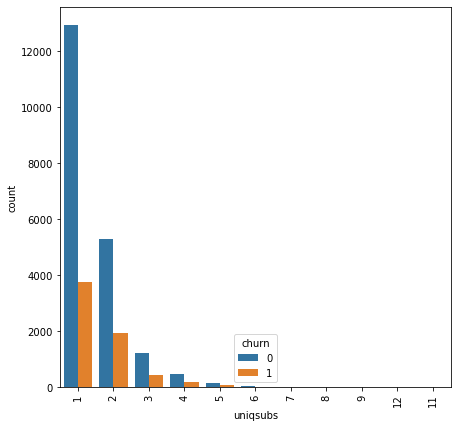

Top categories impacting churn
          churn
uniqsubs       
1         16711
2          7221
3          1655
4           627
5           205
------------------------------------------------ Variable Name: forgntvl ------------------------------------------------
Unique Values:
[ 0.  1. nan]


<Figure size 720x720 with 0 Axes>

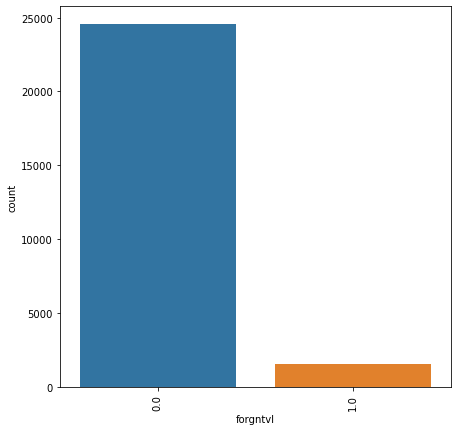

<Figure size 720x720 with 0 Axes>

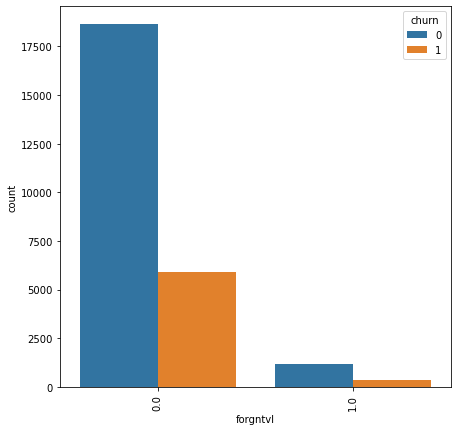

Top categories impacting churn
          churn
forgntvl       
0.0       24539
1.0        1511
------------------------------------------------ Variable Name: dwlltype ------------------------------------------------
Unique Values:
['S' nan 'M']


<Figure size 720x720 with 0 Axes>

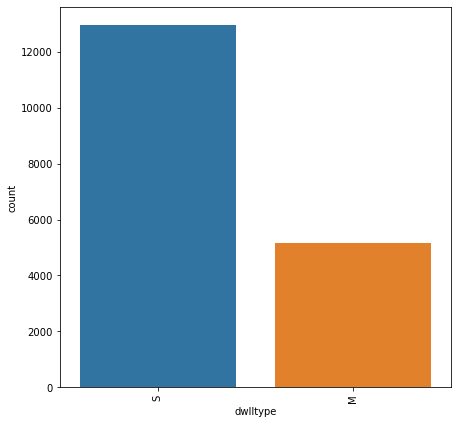

<Figure size 720x720 with 0 Axes>

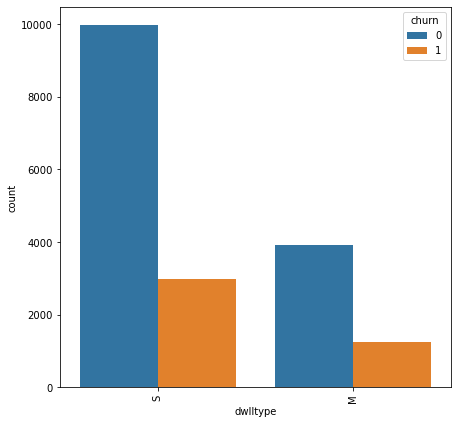

Top categories impacting churn
          churn
dwlltype       
S         12968
M          5169
------------------------------------------------ Variable Name: dwllsize ------------------------------------------------
Unique Values:
['A' nan 'C' 'B' 'K' 'J' 'D' 'L' 'I' 'N' 'E' 'M' 'G' 'O' 'F' 'H']


<Figure size 720x720 with 0 Axes>

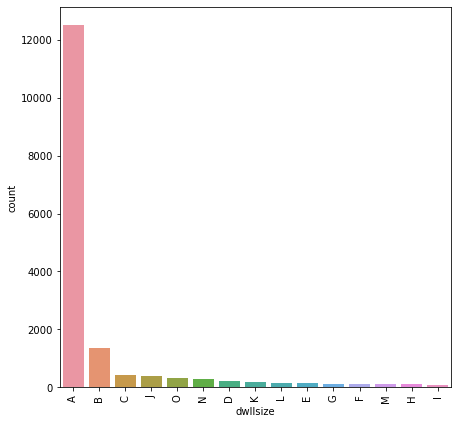

<Figure size 720x720 with 0 Axes>

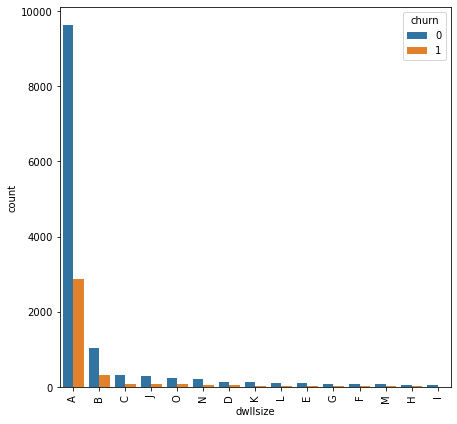

Top categories impacting churn
          churn
dwllsize       
A         12521
B          1348
C           420
J           384
O           315
------------------------------------------------ Variable Name: mailordr ------------------------------------------------
Unique Values:
['B' nan]


<Figure size 720x720 with 0 Axes>

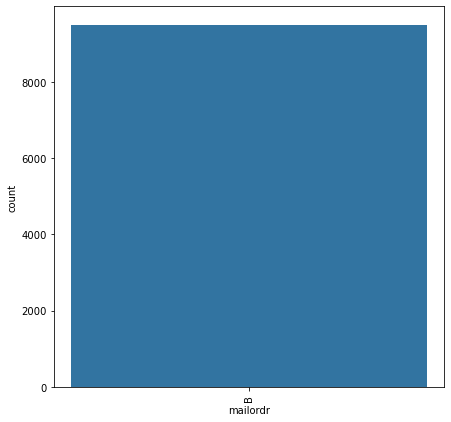

<Figure size 720x720 with 0 Axes>

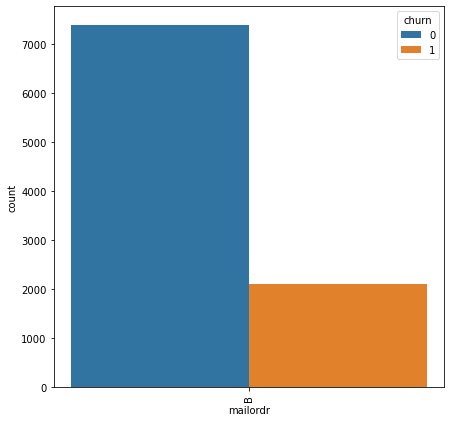

Top categories impacting churn
          churn
mailordr       
B          9508
------------------------------------------------ Variable Name: occu1 ------------------------------------------------
Unique Values:
['A' nan '1' '4' '6' 'E' '5' '3' '2' '7' '8' 'D' 'F' 'H' 'K' 'G' 'C' 'J'
 'B' 'Z' 'I' '9']


<Figure size 720x720 with 0 Axes>

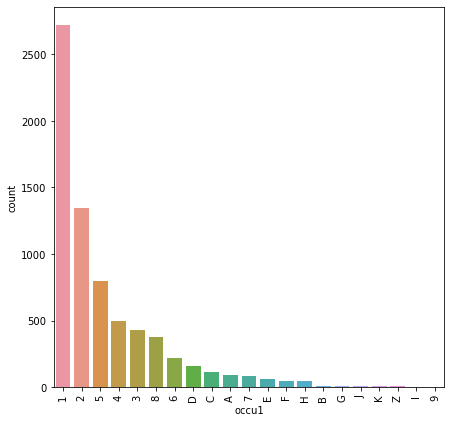

<Figure size 720x720 with 0 Axes>

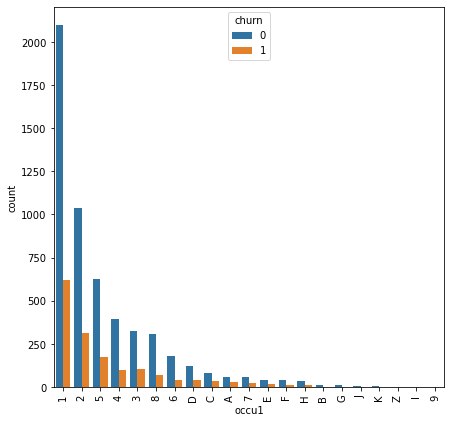

Top categories impacting churn
       churn
occu1       
1       2723
2       1347
5        799
4        493
3        428
------------------------------------------------ Variable Name: mtrcycle ------------------------------------------------
Unique Values:
[ 0.  1. nan]


<Figure size 720x720 with 0 Axes>

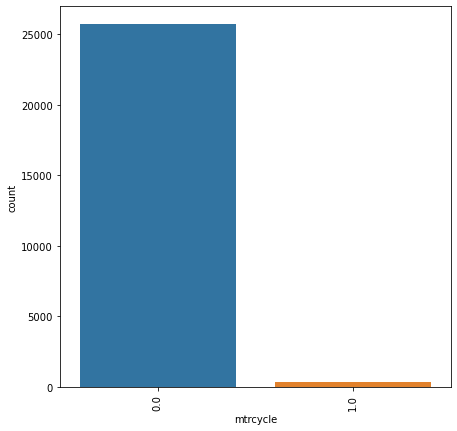

<Figure size 720x720 with 0 Axes>

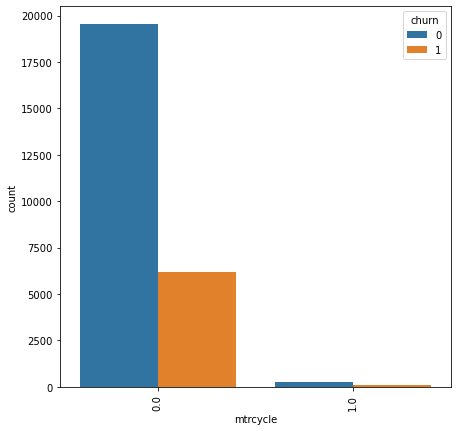

Top categories impacting churn
          churn
mtrcycle       
0.0       25694
1.0         356
------------------------------------------------ Variable Name: numbcars ------------------------------------------------
Unique Values:
[nan  1.  2.  3.]


<Figure size 720x720 with 0 Axes>

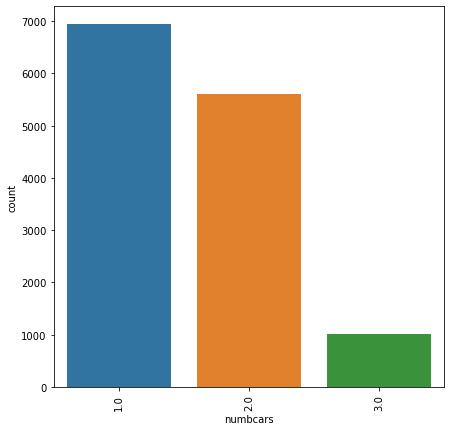

<Figure size 720x720 with 0 Axes>

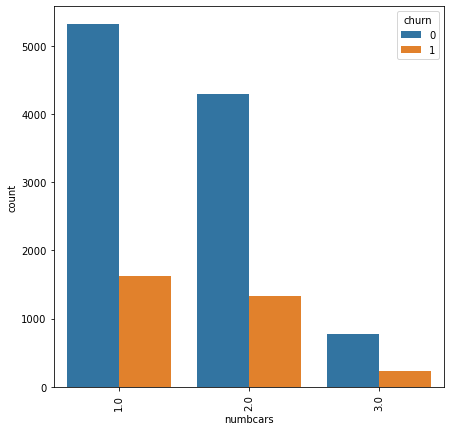

Top categories impacting churn
          churn
numbcars       
1.0        6940
2.0        5616
3.0        1003
------------------------------------------------ Variable Name: truck ------------------------------------------------
Unique Values:
[ 0.  1. nan]


<Figure size 720x720 with 0 Axes>

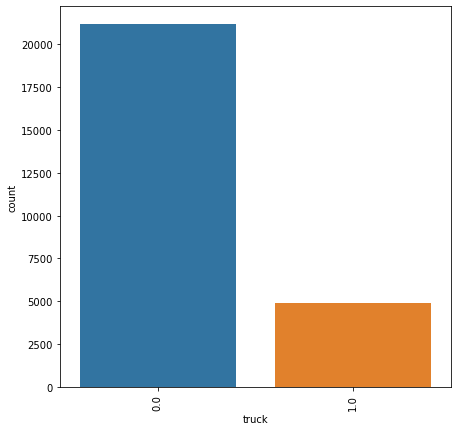

<Figure size 720x720 with 0 Axes>

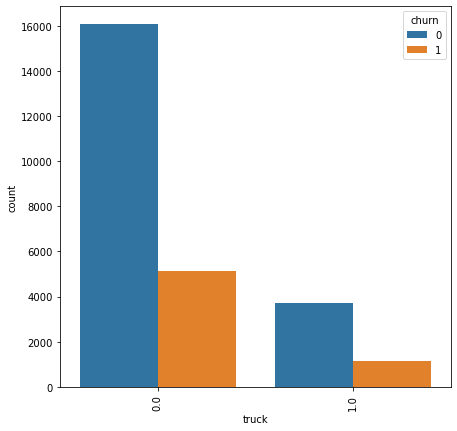

Top categories impacting churn
       churn
truck       
0.0    21167
1.0     4883
------------------------------------------------ Variable Name: wrkwoman ------------------------------------------------
Unique Values:
['Y' nan]


<Figure size 720x720 with 0 Axes>

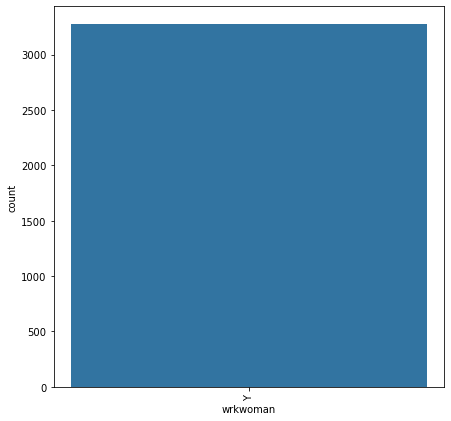

<Figure size 720x720 with 0 Axes>

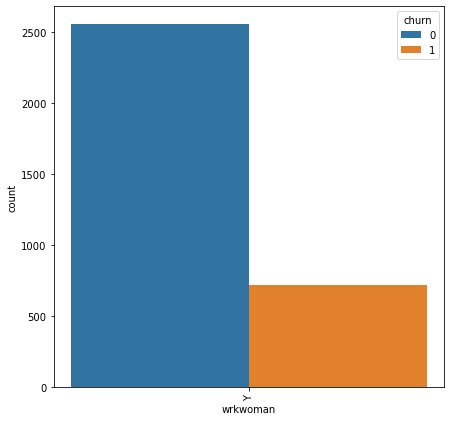

Top categories impacting churn
          churn
wrkwoman       
Y          3272
------------------------------------------------ Variable Name: solflag ------------------------------------------------
Unique Values:
[nan 'N' 'Y']


<Figure size 720x720 with 0 Axes>

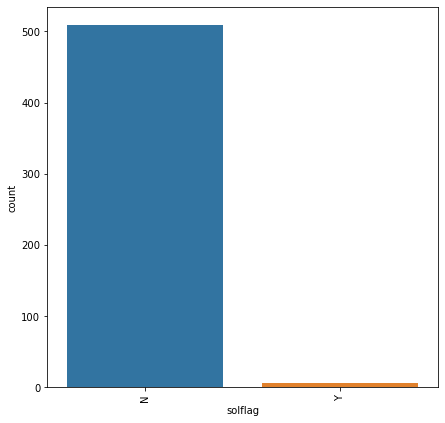

<Figure size 720x720 with 0 Axes>

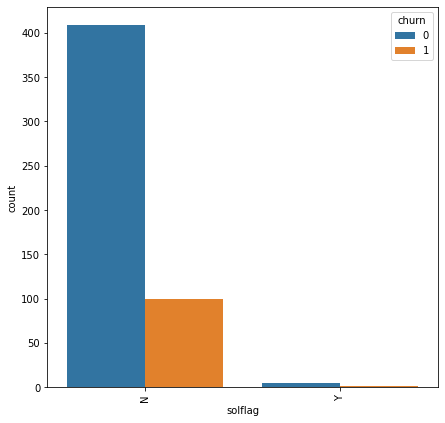

Top categories impacting churn
         churn
solflag       
N          509
Y            6
------------------------------------------------ Variable Name: proptype ------------------------------------------------
Unique Values:
['A' nan 'D' 'B' 'E' 'M' 'G']


<Figure size 720x720 with 0 Axes>

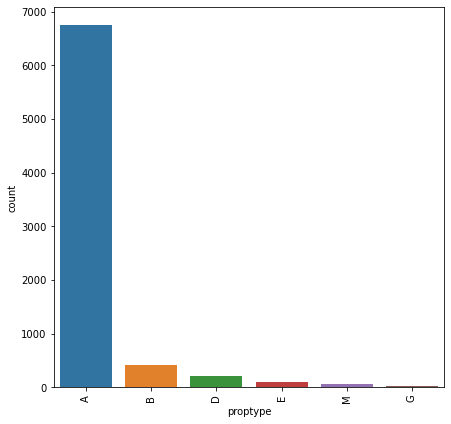

<Figure size 720x720 with 0 Axes>

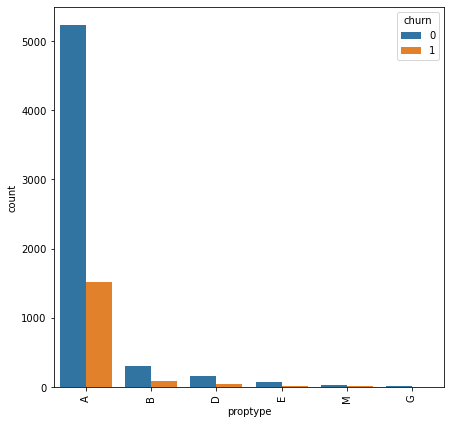

Top categories impacting churn
          churn
proptype       
A          6753
B           406
D           204
E            95
M            55
------------------------------------------------ Variable Name: mailresp ------------------------------------------------
Unique Values:
['R' nan]


<Figure size 720x720 with 0 Axes>

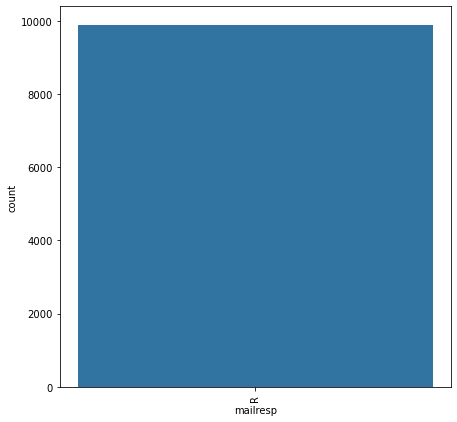

<Figure size 720x720 with 0 Axes>

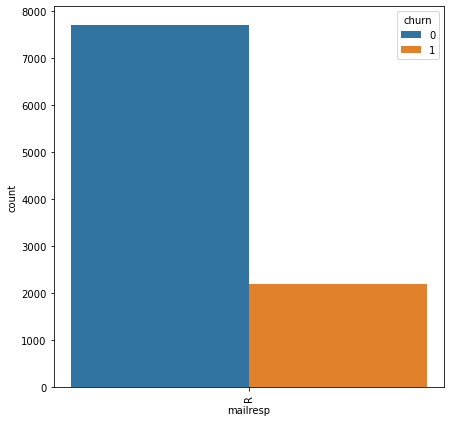

Top categories impacting churn
          churn
mailresp       
R          9896
------------------------------------------------ Variable Name: cartype ------------------------------------------------
Unique Values:
[nan 'E' 'F' 'C' 'A' 'B' 'D' 'G']


<Figure size 720x720 with 0 Axes>

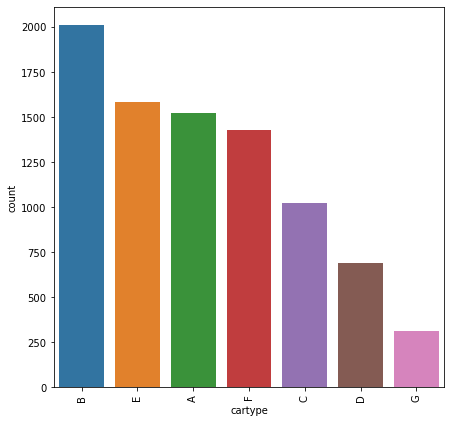

<Figure size 720x720 with 0 Axes>

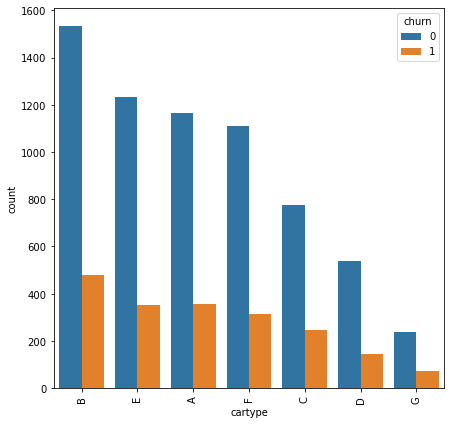

Top categories impacting churn
         churn
cartype       
B         2012
E         1582
A         1524
F         1426
C         1021
------------------------------------------------ Variable Name: car_buy ------------------------------------------------
Unique Values:
['UNKNOWN' 'New' nan]


<Figure size 720x720 with 0 Axes>

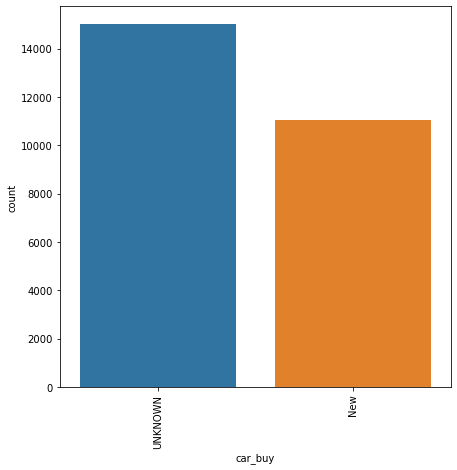

<Figure size 720x720 with 0 Axes>

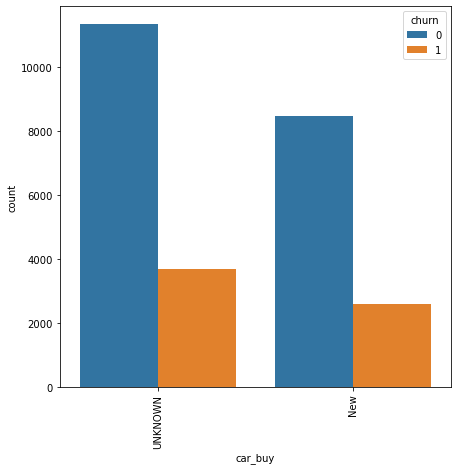

Top categories impacting churn
         churn
car_buy       
UNKNOWN  14999
New      11051
------------------------------------------------ Variable Name: children ------------------------------------------------
Unique Values:
['Y' nan 'N']


<Figure size 720x720 with 0 Axes>

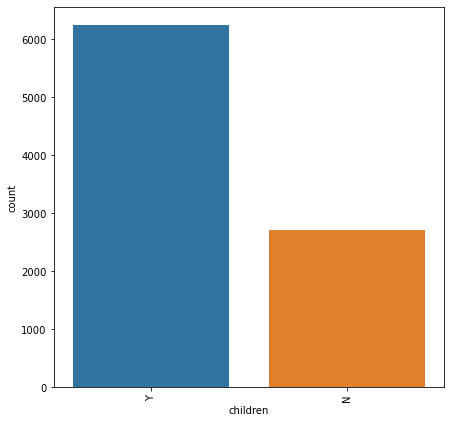

<Figure size 720x720 with 0 Axes>

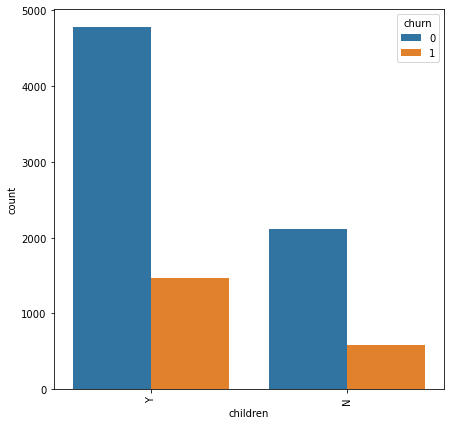

Top categories impacting churn
          churn
children       
Y          6251
N          2705
------------------------------------------------ Variable Name: csa ------------------------------------------------
Unique Values:
['AIRCOL803' 'LAXCUL310' 'STLSTL314' 'LAXANA714' 'NCRGRB757' 'ATLATL678'
 'APCFCH703' 'NYCNEW201' 'OKCOKC405' 'SLCOGD801' 'OMADES515' 'NYCMAN917'
 'APCSIL301' 'NYCNAS516' 'LAXLAX213' 'HARNEW203' 'NYCBRO917' 'NYCQUE917'
 'NYCWHI914' 'PHXTUC520' 'CHIDAV319' 'SEASEA206' 'INDIND317' 'OHISAN419'
 'MINMIN612' 'BOSNSH603' 'LAXCOV626' 'FLNKIS407' 'SFRCBL408' 'HARSPR413'
 'HOUHOU281' 'APCBAL410' 'DALDAL214' 'SFRSCL408' 'BOSMAN603' 'NORZIM763'
 'NCRNWN757' 'AWISHE920' 'NYCNEW908' 'HOUGLV409' 'MIAMIA305' 'OHICAN330'
 'AIRSPA864' 'NYCSUF516' 'LAXBUR818' 'LAXONT909' 'SANKIL254' 'DENBOU303'
 'SFRSFR415' 'SFRSRO707' 'NCRVIR757' 'ATLMEM901' 'HWIMAU808' 'DENGLD303'
 'DETROS810' 'BOSBOS617' 'PHIPHI215' 'DENDEN303' 'MIAWPB561' 'ATLNOR678'
 'MIAFTL954' 'DETDET313' 'HARBRI203' 'NEVES

<Figure size 720x720 with 0 Axes>

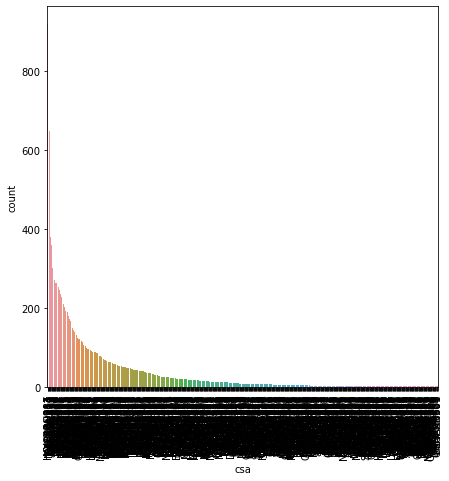

<Figure size 720x720 with 0 Axes>

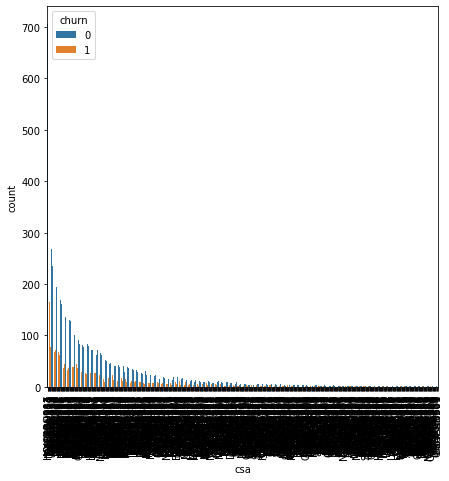

Top categories impacting churn
           churn
csa             
NYCBRO917    918
HOUHOU281    784
DALDAL214    762
NYCMAN917    649
APCFCH703    414
------------------------------------------------ Variable Name: div_type ------------------------------------------------
Unique Values:
[nan 'LDD' 'BTH' 'LTD']


<Figure size 720x720 with 0 Axes>

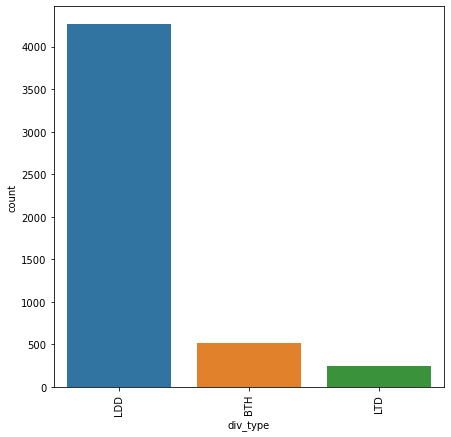

<Figure size 720x720 with 0 Axes>

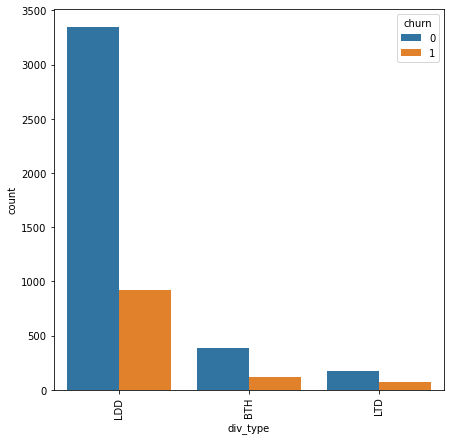

Top categories impacting churn
          churn
div_type       
LDD        4260
BTH         512
LTD         245


In [25]:
bivariate_analyze_cat(df,df_cat_temp,dep_var='churn')

### Continuous Variables

In [35]:
df_cont_temp.shape

(26518, 47)

IndexError: index 24 is out of bounds for axis 0 with size 24

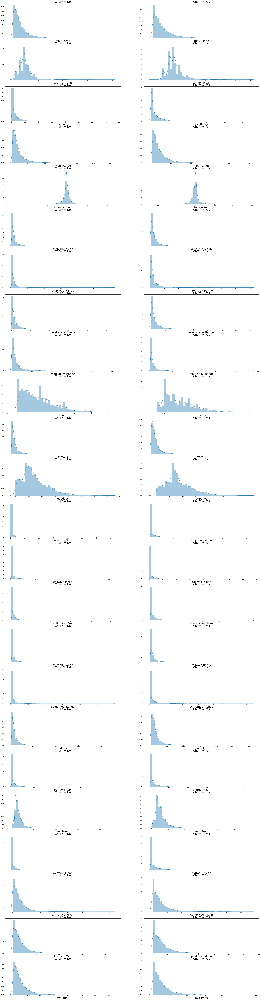

In [34]:
fig, axs = plt.subplots(24, 2,figsize=(50,200))
j=0
k=0
for col in df_cont_temp:
    if df[col].dtype != 'object':
        try:
            if k%2==0:
                ax=sns.distplot(df[df['churn']==0][col],ax=axs[j,k])
                ax.set_title('Churn = No',fontsize=30)
                ax.set_xlabel(col,fontsize=30)
                k=k+1
            if k%2!=0:
                ax=sns.distplot(df[df['churn']==1][col],ax=axs[j,k])
                ax.set_title('Churn = Yes',fontsize=30)
                ax.set_xlabel(col,fontsize=30)
        except RuntimeError as re:
            if str(re).startswith("Selected KDE bandwidth is 0. Cannot estiamte density."):
                if k%2==0:
                    ax=sns.distplot(df[df['churn']==0][col],ax=axs[j,k],kde_kws={'bw': 0.1})
                    ax.set_title('Churn = No',fontsize=30)
                    ax.set_xlabel(col,fontsize=30)
                    k=k+1
                if k%2!=0:
                    ax=sns.distplot(df[df['churn']==1][col],ax=axs[j,k],kde_kws={'bw': 0.1})
                    ax.set_title('Churn = Yes',fontsize=30)
                    ax.set_xlabel(col,fontsize=30)
            else:
                raise re
        #axs[j,k].set_xlabel('')
    k=k+1
    if k==2:
        k=0
        j=j+1
fig.tight_layout()
fig.savefig('Cont_bivariate.jpg')
plt.show()

### PairPlot

In [23]:
sns.pairplot(df)

### Categorical Variables

In [21]:
def bivariate_analyze_cat(df,df_cat,dep_var):
    for col in df_cat:
        if col == dep_var:
            continue
        else:
            print("------------------------------------------------ Variable Name: "+col+" ------------------------------------------------" )
            print("Unique Values:")
            print(df[col].unique())
            plt.figure(figsize=(10,10))
            plt.figure(figsize=(7,7))
            ax=sns.countplot(df[col],order= df[col].value_counts().index)
            ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
            plt.show()
            plt.figure(figsize=(10,10))
            plt.figure(figsize=(7,7))
            ax=sns.countplot(df[col],hue=df[dep_var],order= df[col].value_counts().index)
            ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
            plt.show()
            print('Top categories impacting churn')
            print(df[[dep_var]].groupby(df[col]).count().sort_values(by=dep_var,ascending=False).head())

------------------------------------------------ Variable Name: income ------------------------------------------------
Unique Values:
[ 9.  6.  8.  5. nan  3.  7.  2.  1.  4.]


<Figure size 720x720 with 0 Axes>

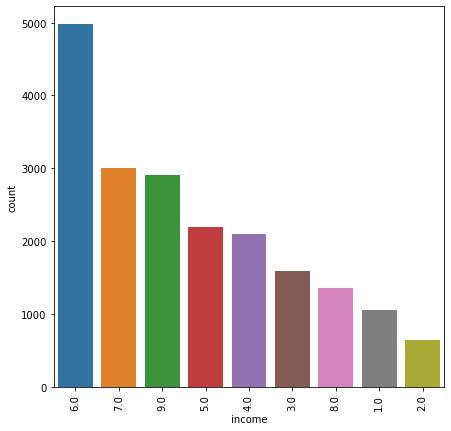

<Figure size 720x720 with 0 Axes>

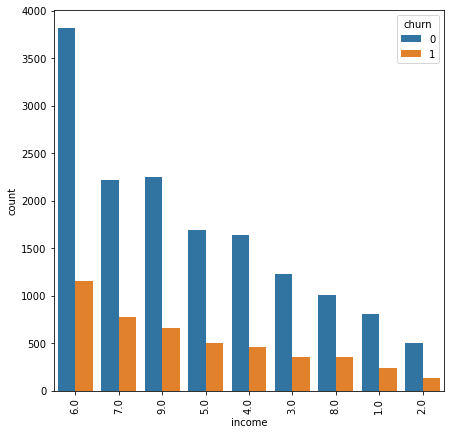

Top categories impacting churn
        churn
income       
6.0      4976
7.0      3003
9.0      2907
5.0      2199
4.0      2103
------------------------------------------------ Variable Name: crclscod ------------------------------------------------
Unique Values:
['AA' 'EA' 'C' 'G' 'CA' 'E4' 'E' 'B' 'BA' 'O' 'A' 'DA' 'U' 'ZA' 'D4' 'A2'
 'D5' 'C2' 'GA' 'Z4' 'JF' 'IF' 'ZY' 'GY' 'Z' 'CC' 'I' 'B2' 'EM' 'E2' 'K'
 'M' 'EC' 'V1' 'CY' 'D' 'U1' 'Z5' 'C5' 'W' 'J' 'H' 'EF' 'Y' 'TP' 'A3' 'Z2'
 'Z1' 'D2']


<Figure size 720x720 with 0 Axes>

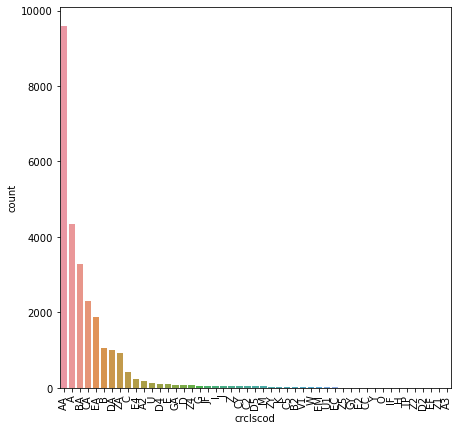

<Figure size 720x720 with 0 Axes>

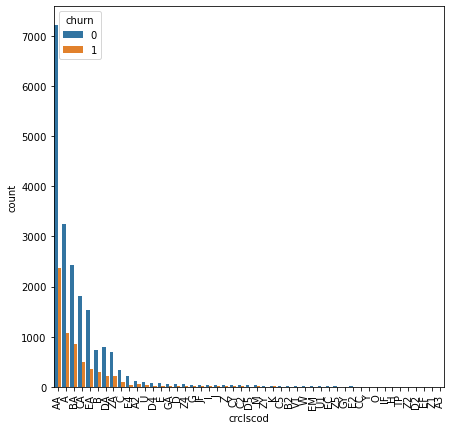

Top categories impacting churn
          churn
crclscod       
AA         9602
A          4338
BA         3283
CA         2298
EA         1889
------------------------------------------------ Variable Name: asl_flag ------------------------------------------------
Unique Values:
['N' 'Y']


<Figure size 720x720 with 0 Axes>

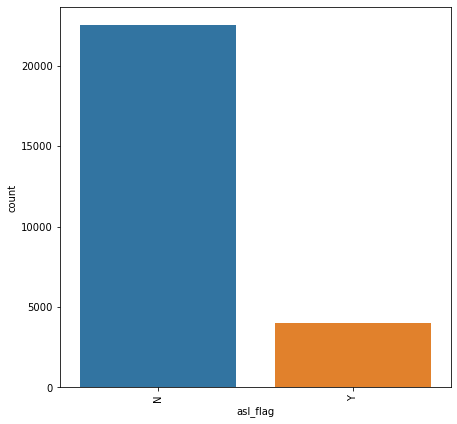

<Figure size 720x720 with 0 Axes>

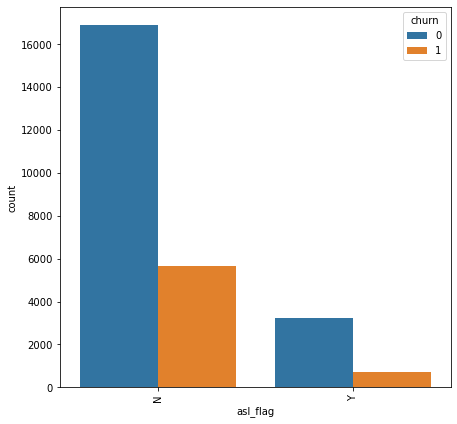

Top categories impacting churn
          churn
asl_flag       
N         22535
Y          3983
------------------------------------------------ Variable Name: prizm_social_one ------------------------------------------------
Unique Values:
['T' 'U' 'C' 'S' 'R' nan]


<Figure size 720x720 with 0 Axes>

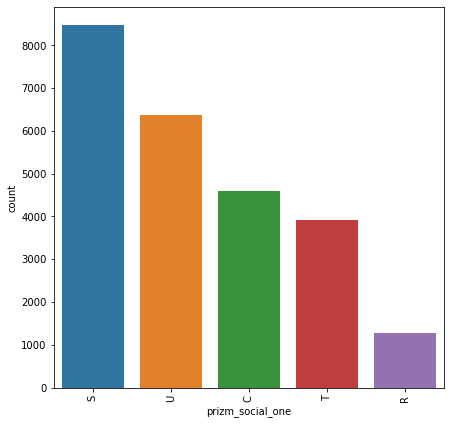

<Figure size 720x720 with 0 Axes>

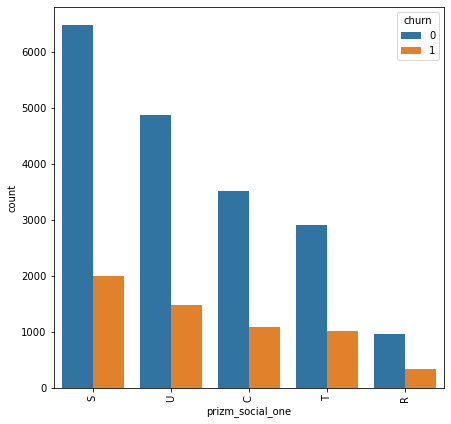

Top categories impacting churn
                  churn
prizm_social_one       
S                  8475
U                  6368
C                  4594
T                  3921
R                  1279
------------------------------------------------ Variable Name: area ------------------------------------------------
Unique Values:
['ATLANTIC SOUTH AREA' 'LOS ANGELES AREA' 'MIDWEST AREA'
 'DC/MARYLAND/VIRGINIA AREA' 'NEW YORK CITY AREA' 'DALLAS AREA'
 'NORTHWEST/ROCKY MOUNTAIN AREA' 'NEW ENGLAND AREA' 'SOUTHWEST AREA'
 'CHICAGO AREA' 'OHIO AREA' 'NORTH FLORIDA AREA' 'CALIFORNIA NORTH AREA'
 'HOUSTON AREA' 'SOUTH FLORIDA AREA' 'CENTRAL/SOUTH TEXAS AREA'
 'TENNESSEE AREA' 'GREAT LAKES AREA' 'PHILADELPHIA AREA' nan]


<Figure size 720x720 with 0 Axes>

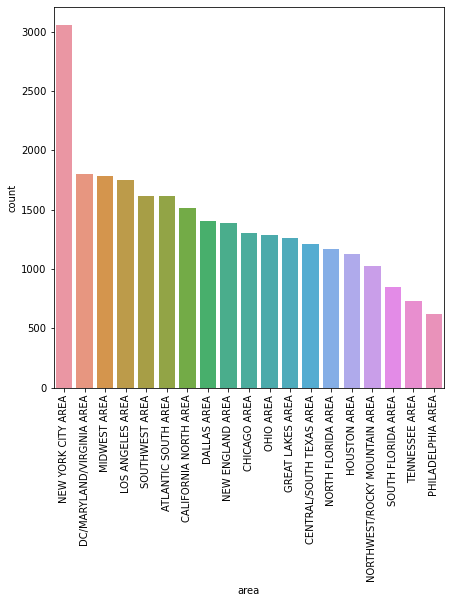

<Figure size 720x720 with 0 Axes>

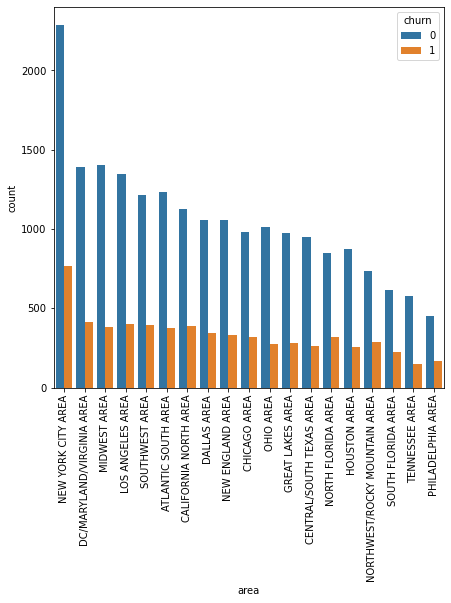

Top categories impacting churn
                           churn
area                            
NEW YORK CITY AREA          3055
DC/MARYLAND/VIRGINIA AREA   1805
MIDWEST AREA                1782
LOS ANGELES AREA            1750
SOUTHWEST AREA              1613
------------------------------------------------ Variable Name: refurb_new ------------------------------------------------
Unique Values:
['N' 'R']


<Figure size 720x720 with 0 Axes>

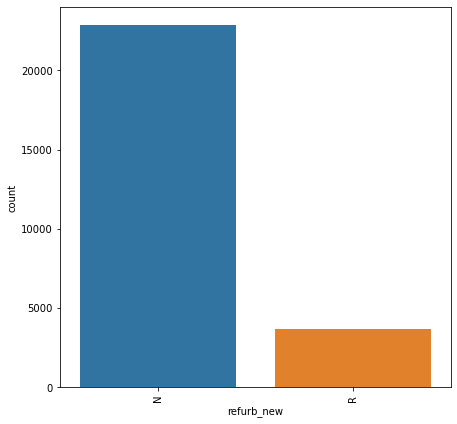

<Figure size 720x720 with 0 Axes>

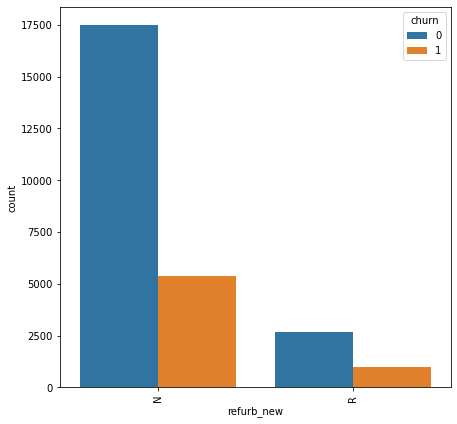

Top categories impacting churn
            churn
refurb_new       
N           22863
R            3655
------------------------------------------------ Variable Name: hnd_webcap ------------------------------------------------
Unique Values:
['WCMB' 'WC' nan 'UNKW']


<Figure size 720x720 with 0 Axes>

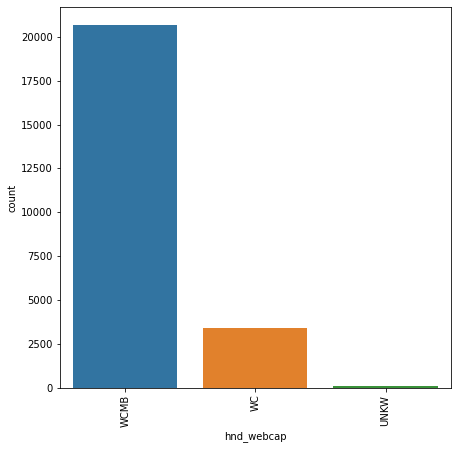

<Figure size 720x720 with 0 Axes>

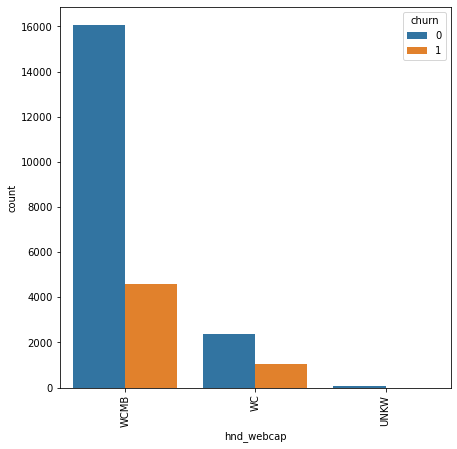

Top categories impacting churn
            churn
hnd_webcap       
WCMB        20660
WC           3408
UNKW           68
------------------------------------------------ Variable Name: marital ------------------------------------------------
Unique Values:
['M' 'U' 'B' 'S' 'A' nan]


<Figure size 720x720 with 0 Axes>

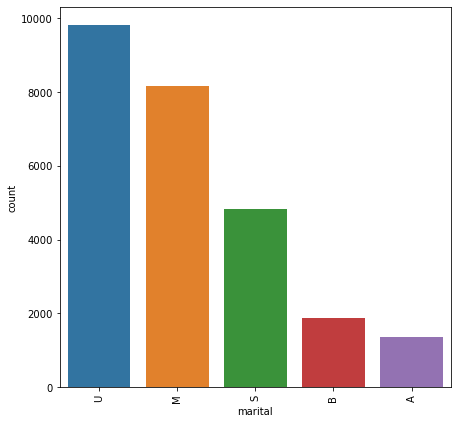

<Figure size 720x720 with 0 Axes>

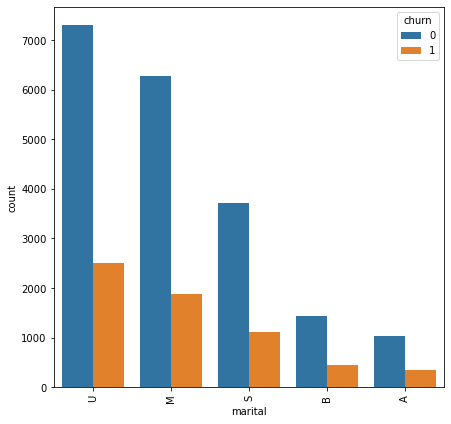

Top categories impacting churn
         churn
marital       
U         9821
M         8159
S         4829
B         1880
A         1361
------------------------------------------------ Variable Name: ethnic ------------------------------------------------
Unique Values:
['N' 'S' 'U' 'H' 'R' 'G' 'O' 'D' 'Z' 'F' 'I' nan 'J' 'B' 'P' 'M' 'X' 'C']


<Figure size 720x720 with 0 Axes>

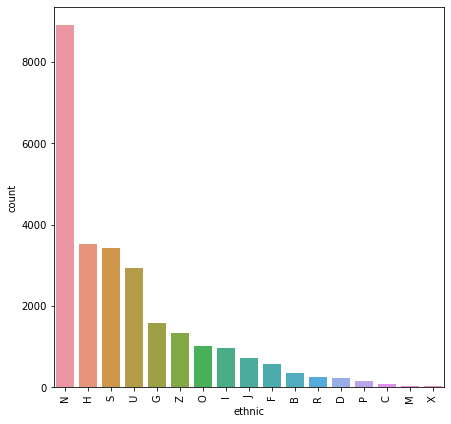

<Figure size 720x720 with 0 Axes>

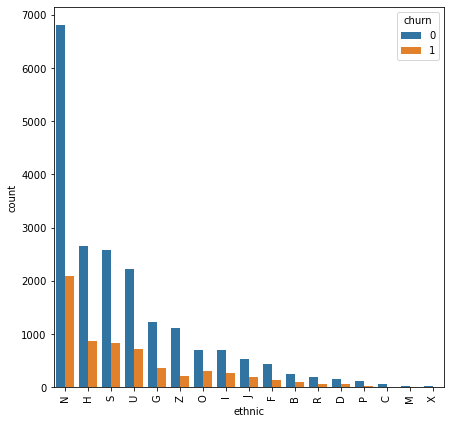

Top categories impacting churn
        churn
ethnic       
N        8912
H        3512
S        3417
U        2940
G        1584
------------------------------------------------ Variable Name: age1 ------------------------------------------------
Unique Values:
[36.  0. 32. 34. 78. 50. 40. 54. 28. 22. 46. 24. 56. 26. 42. 30. 60. 58.
 44. 38. 48. 70. 52. nan 64. 72. 66. 18. 88. 68. 80. 62. 76. 82. 20. 86.
 84. 74. 94. 90. 92.]


<Figure size 720x720 with 0 Axes>

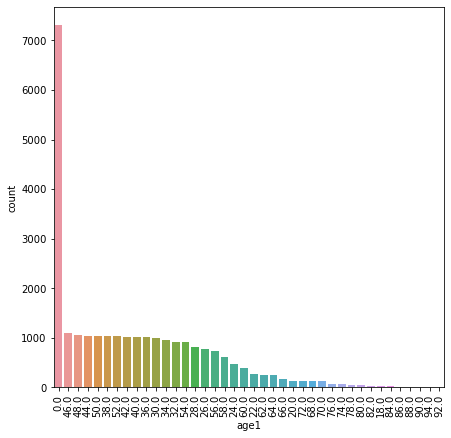

<Figure size 720x720 with 0 Axes>

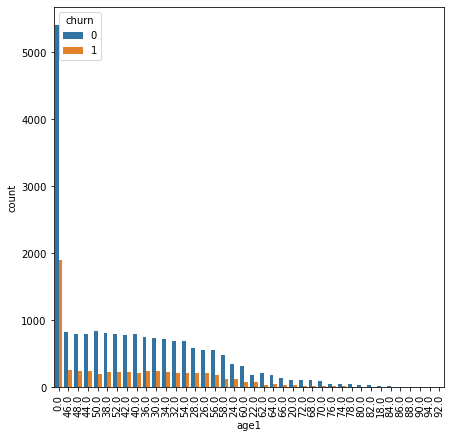

Top categories impacting churn
      churn
age1       
0.0    7309
46.0   1093
48.0   1050
50.0   1037
44.0   1037
------------------------------------------------ Variable Name: age2 ------------------------------------------------
Unique Values:
[ 0. 30. 38. 48. 42. 52. 72. 54. 46. 56. 32. 28. 24. 44. 20. 50. 26. 40.
 22. 60. nan 66. 18. 36. 70. 86. 34. 58. 64. 78. 82. 68. 62. 76. 74. 90.
 80. 94. 84. 92. 98. 88. 96. 99.]


<Figure size 720x720 with 0 Axes>

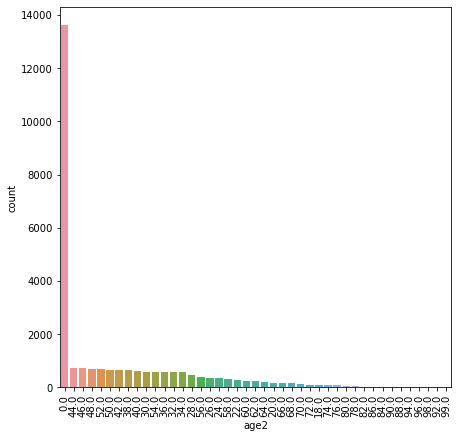

<Figure size 720x720 with 0 Axes>

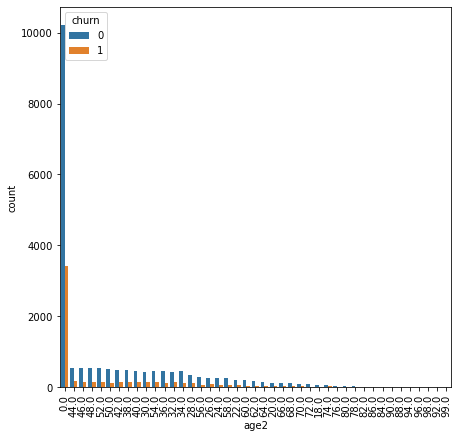

Top categories impacting churn
      churn
age2       
0.0   13627
44.0    727
46.0    721
48.0    711
52.0    683
------------------------------------------------ Variable Name: models ------------------------------------------------
Unique Values:
[ 1  2  4  3  5  6  8  7 15  9 10]


<Figure size 720x720 with 0 Axes>

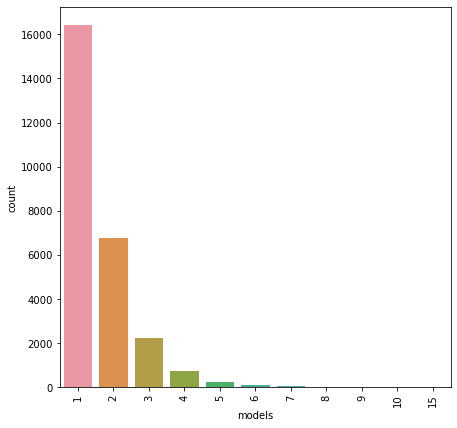

<Figure size 720x720 with 0 Axes>

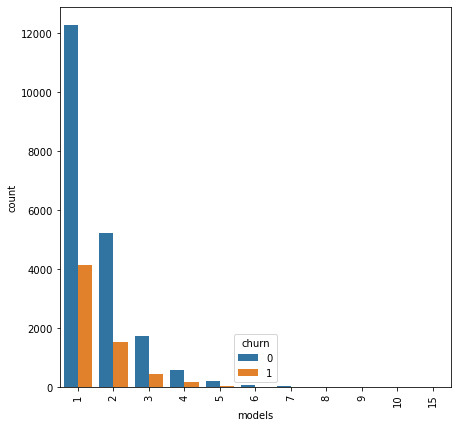

Top categories impacting churn
        churn
models       
1       16441
2        6765
3        2203
4         734
5         238
------------------------------------------------ Variable Name: hnd_price ------------------------------------------------
Unique Values:
[199.9899902  149.9899902   99.98999023  29.98999023  79.98999023
  59.98999023 129.9899902    9.98999786 299.9899902  249.9899902
          nan 179.9899902   39.98999023 499.9899902  399.9899902
 239.9899902  119.9899902 ]


<Figure size 720x720 with 0 Axes>

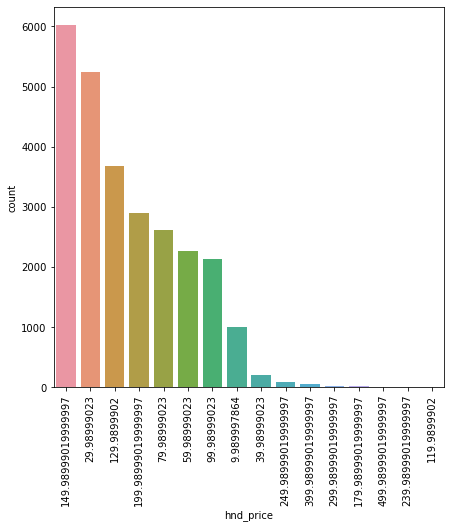

<Figure size 720x720 with 0 Axes>

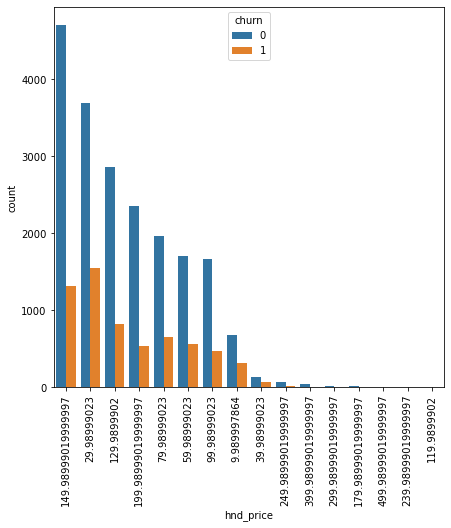

Top categories impacting churn
           churn
hnd_price       
149.98999   6025
29.98999    5244
129.98999   3684
199.98999   2893
79.98999    2616
------------------------------------------------ Variable Name: actvsubs ------------------------------------------------
Unique Values:
[ 2  1  3  4  5  0  8 11  6  7]


<Figure size 720x720 with 0 Axes>

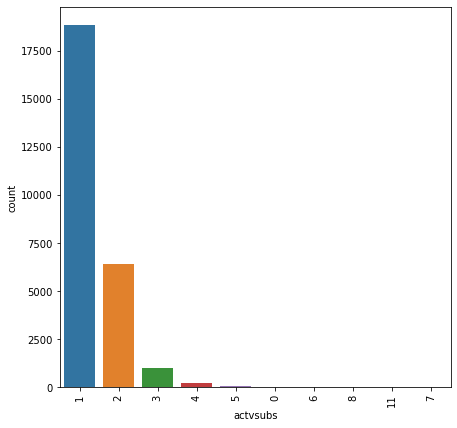

<Figure size 720x720 with 0 Axes>

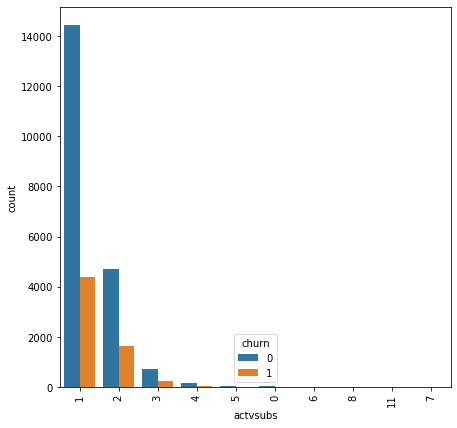

Top categories impacting churn
          churn
actvsubs       
1         18848
2          6379
3           977
4           204
5            73
------------------------------------------------ Variable Name: uniqsubs ------------------------------------------------
Unique Values:
[ 2  1  3  5  4  6  7  8 11  9 12]


<Figure size 720x720 with 0 Axes>

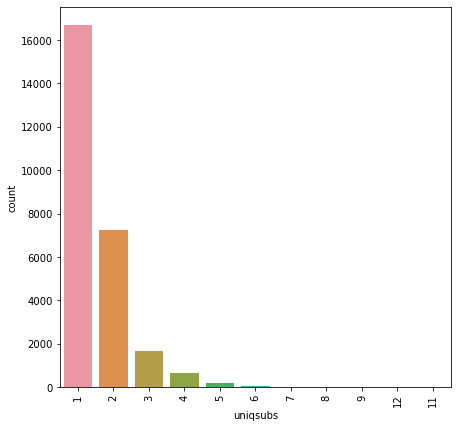

<Figure size 720x720 with 0 Axes>

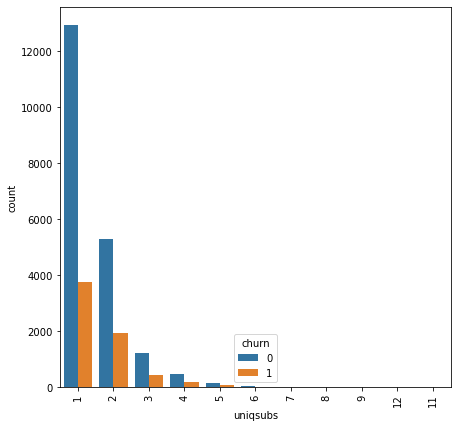

Top categories impacting churn
          churn
uniqsubs       
1         16711
2          7221
3          1655
4           627
5           205
------------------------------------------------ Variable Name: forgntvl ------------------------------------------------
Unique Values:
[ 0.  1. nan]


<Figure size 720x720 with 0 Axes>

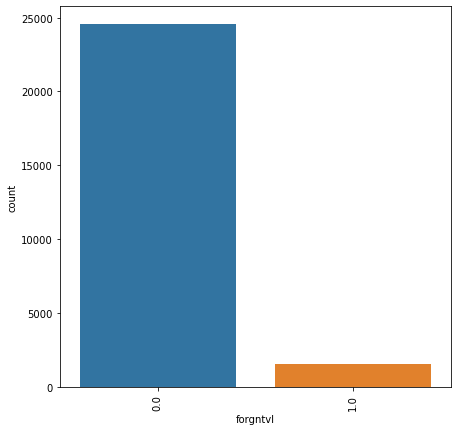

<Figure size 720x720 with 0 Axes>

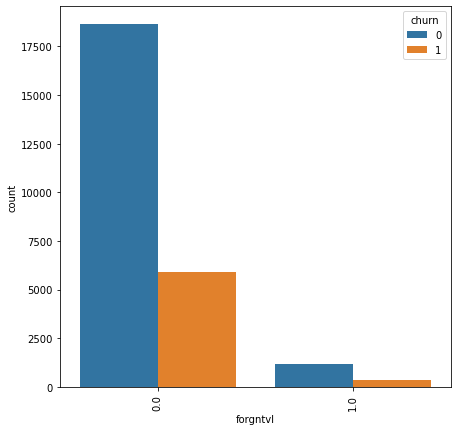

Top categories impacting churn
          churn
forgntvl       
0.0       24539
1.0        1511
------------------------------------------------ Variable Name: dwlltype ------------------------------------------------
Unique Values:
['S' nan 'M']


<Figure size 720x720 with 0 Axes>

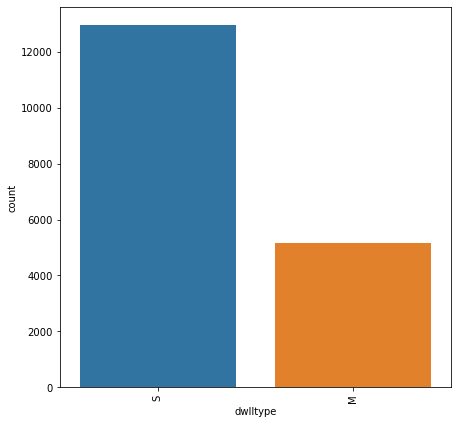

<Figure size 720x720 with 0 Axes>

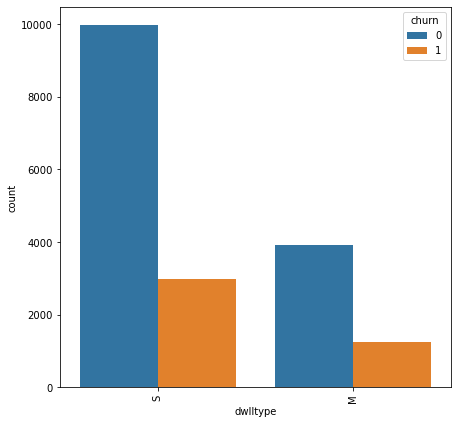

Top categories impacting churn
          churn
dwlltype       
S         12968
M          5169
------------------------------------------------ Variable Name: dwllsize ------------------------------------------------
Unique Values:
['A' nan 'C' 'B' 'K' 'J' 'D' 'L' 'I' 'N' 'E' 'M' 'G' 'O' 'F' 'H']


<Figure size 720x720 with 0 Axes>

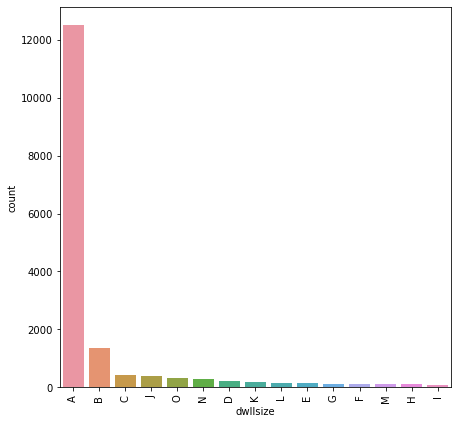

<Figure size 720x720 with 0 Axes>

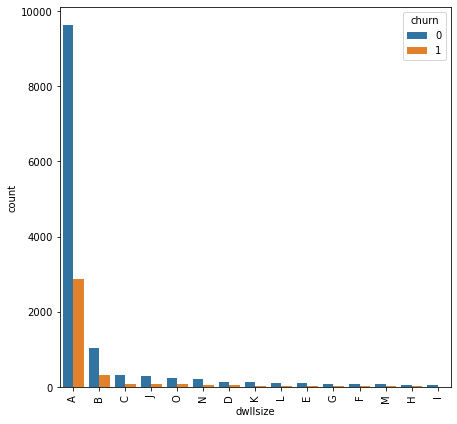

Top categories impacting churn
          churn
dwllsize       
A         12521
B          1348
C           420
J           384
O           315
------------------------------------------------ Variable Name: mailordr ------------------------------------------------
Unique Values:
['B' nan]


<Figure size 720x720 with 0 Axes>

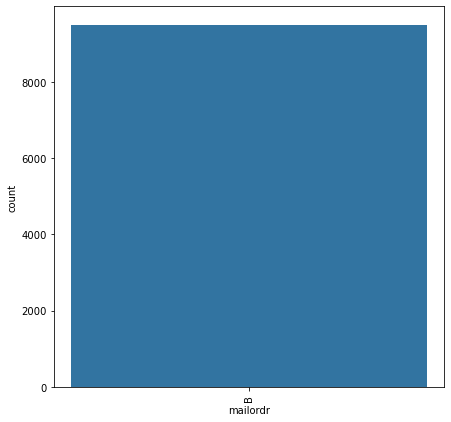

<Figure size 720x720 with 0 Axes>

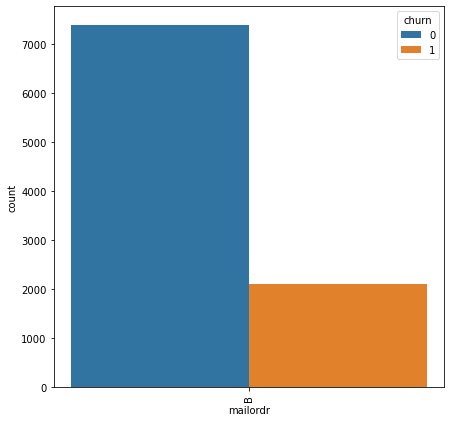

Top categories impacting churn
          churn
mailordr       
B          9508
------------------------------------------------ Variable Name: occu1 ------------------------------------------------
Unique Values:
['A' nan '1' '4' '6' 'E' '5' '3' '2' '7' '8' 'D' 'F' 'H' 'K' 'G' 'C' 'J'
 'B' 'Z' 'I' '9']


<Figure size 720x720 with 0 Axes>

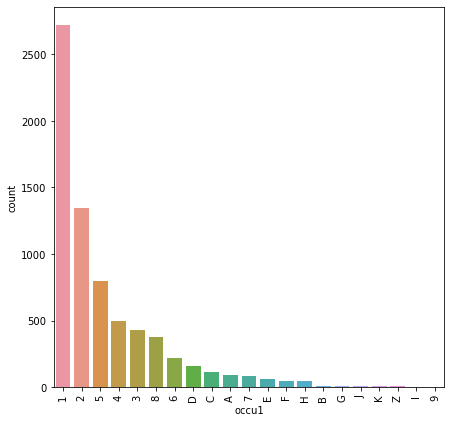

<Figure size 720x720 with 0 Axes>

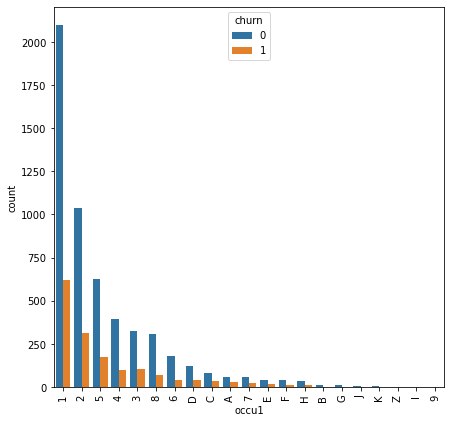

Top categories impacting churn
       churn
occu1       
1       2723
2       1347
5        799
4        493
3        428
------------------------------------------------ Variable Name: mtrcycle ------------------------------------------------
Unique Values:
[ 0.  1. nan]


<Figure size 720x720 with 0 Axes>

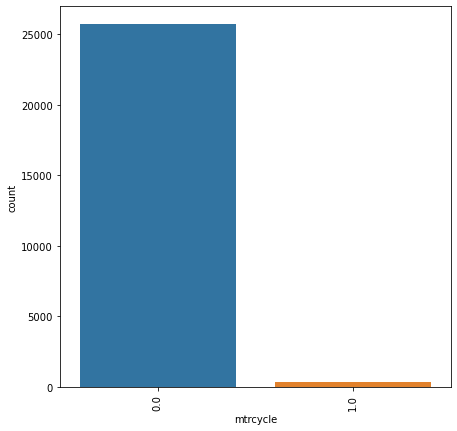

<Figure size 720x720 with 0 Axes>

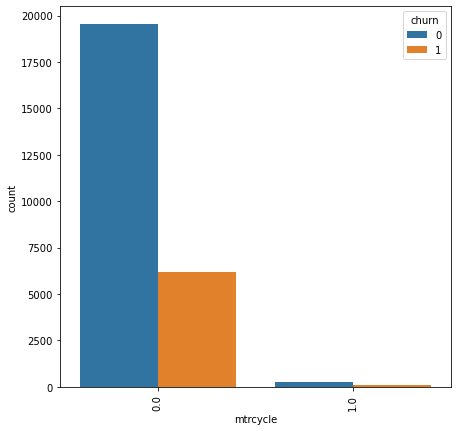

Top categories impacting churn
          churn
mtrcycle       
0.0       25694
1.0         356
------------------------------------------------ Variable Name: numbcars ------------------------------------------------
Unique Values:
[nan  1.  2.  3.]


<Figure size 720x720 with 0 Axes>

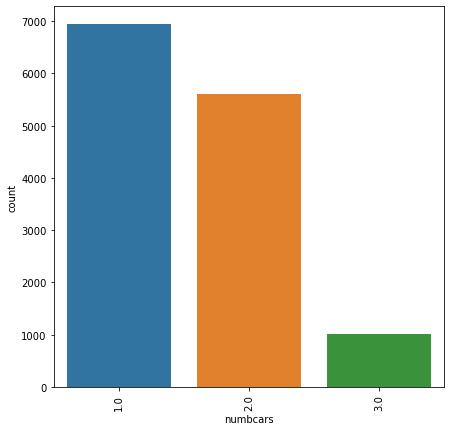

<Figure size 720x720 with 0 Axes>

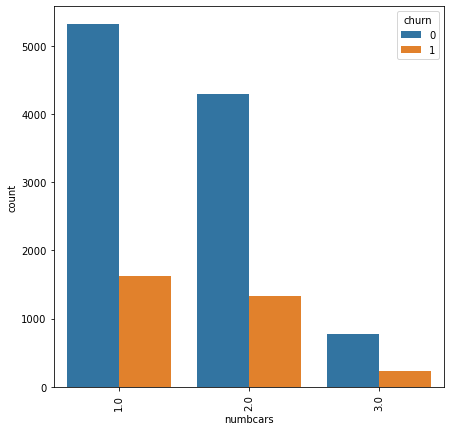

Top categories impacting churn
          churn
numbcars       
1.0        6940
2.0        5616
3.0        1003
------------------------------------------------ Variable Name: truck ------------------------------------------------
Unique Values:
[ 0.  1. nan]


<Figure size 720x720 with 0 Axes>

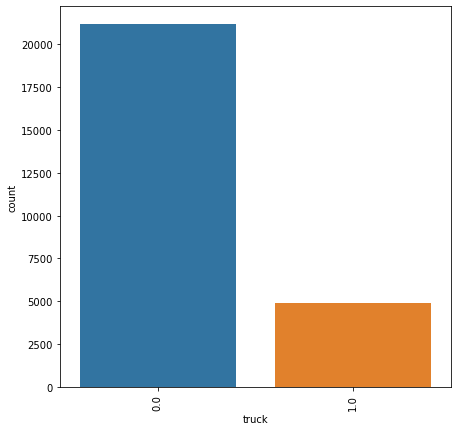

<Figure size 720x720 with 0 Axes>

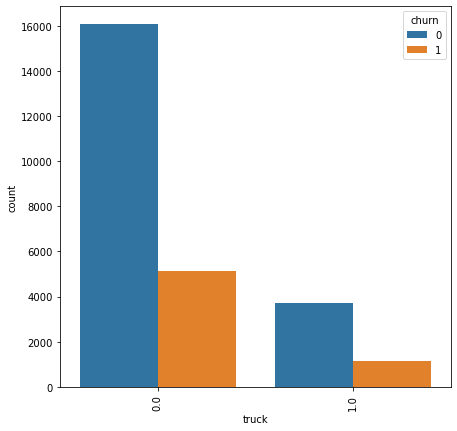

Top categories impacting churn
       churn
truck       
0.0    21167
1.0     4883
------------------------------------------------ Variable Name: wrkwoman ------------------------------------------------
Unique Values:
['Y' nan]


<Figure size 720x720 with 0 Axes>

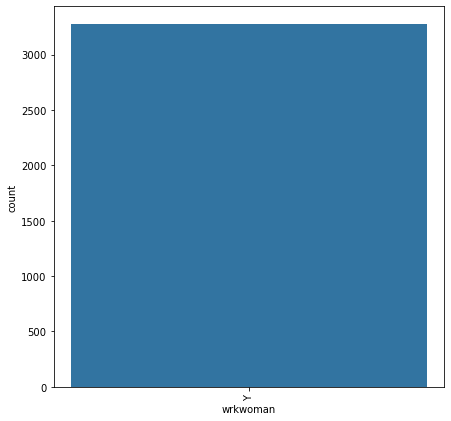

<Figure size 720x720 with 0 Axes>

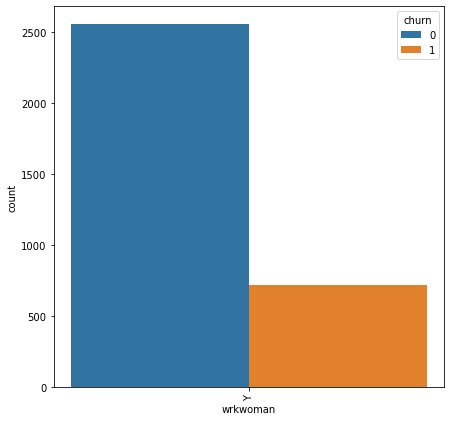

Top categories impacting churn
          churn
wrkwoman       
Y          3272
------------------------------------------------ Variable Name: solflag ------------------------------------------------
Unique Values:
[nan 'N' 'Y']


<Figure size 720x720 with 0 Axes>

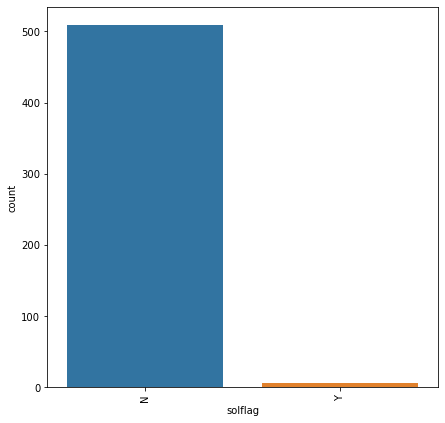

<Figure size 720x720 with 0 Axes>

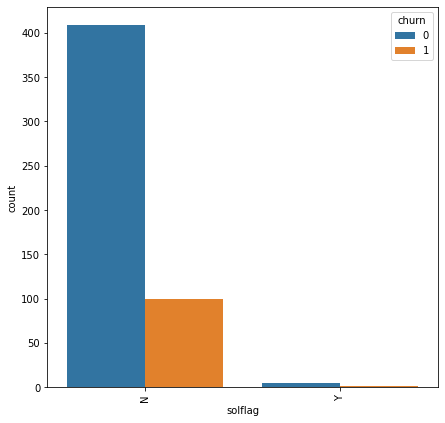

Top categories impacting churn
         churn
solflag       
N          509
Y            6
------------------------------------------------ Variable Name: proptype ------------------------------------------------
Unique Values:
['A' nan 'D' 'B' 'E' 'M' 'G']


<Figure size 720x720 with 0 Axes>

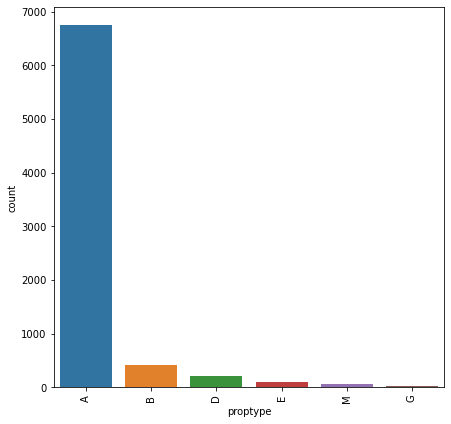

<Figure size 720x720 with 0 Axes>

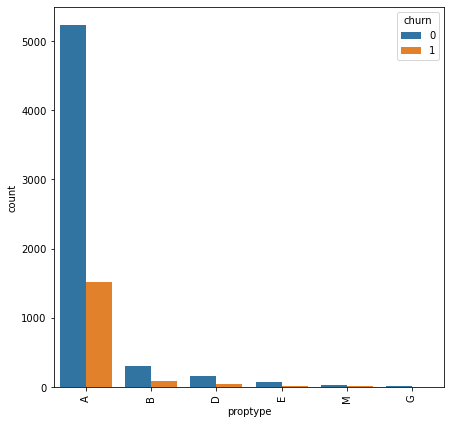

Top categories impacting churn
          churn
proptype       
A          6753
B           406
D           204
E            95
M            55
------------------------------------------------ Variable Name: mailresp ------------------------------------------------
Unique Values:
['R' nan]


<Figure size 720x720 with 0 Axes>

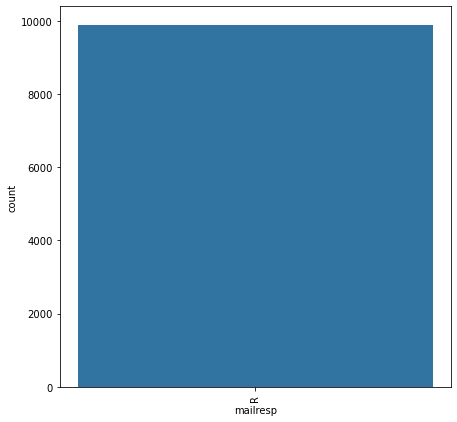

<Figure size 720x720 with 0 Axes>

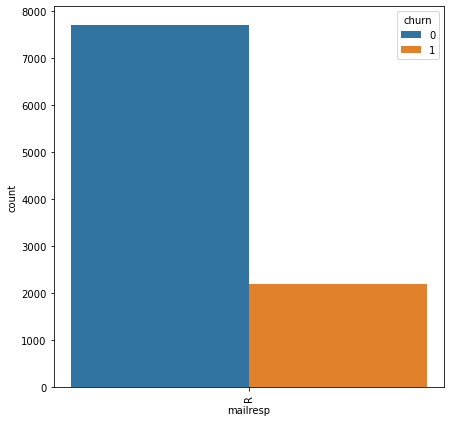

Top categories impacting churn
          churn
mailresp       
R          9896
------------------------------------------------ Variable Name: cartype ------------------------------------------------
Unique Values:
[nan 'E' 'F' 'C' 'A' 'B' 'D' 'G']


<Figure size 720x720 with 0 Axes>

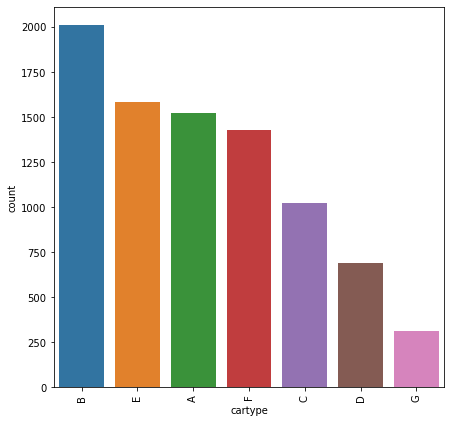

<Figure size 720x720 with 0 Axes>

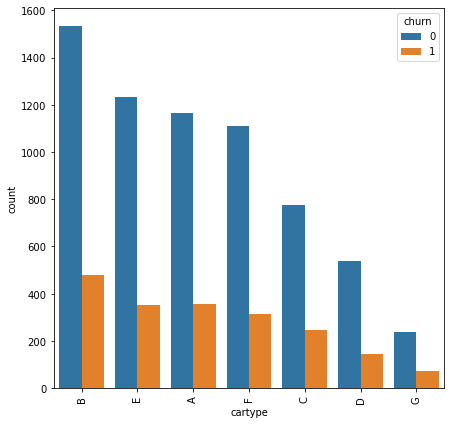

Top categories impacting churn
         churn
cartype       
B         2012
E         1582
A         1524
F         1426
C         1021
------------------------------------------------ Variable Name: car_buy ------------------------------------------------
Unique Values:
['UNKNOWN' 'New' nan]


<Figure size 720x720 with 0 Axes>

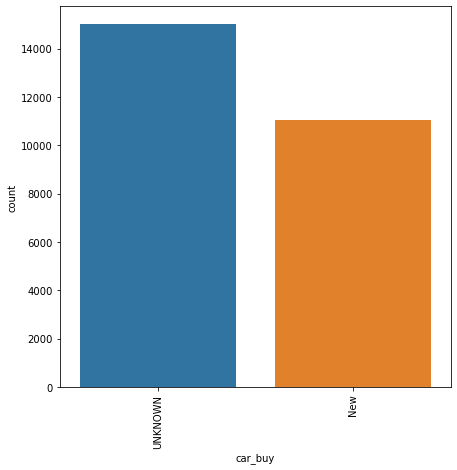

<Figure size 720x720 with 0 Axes>

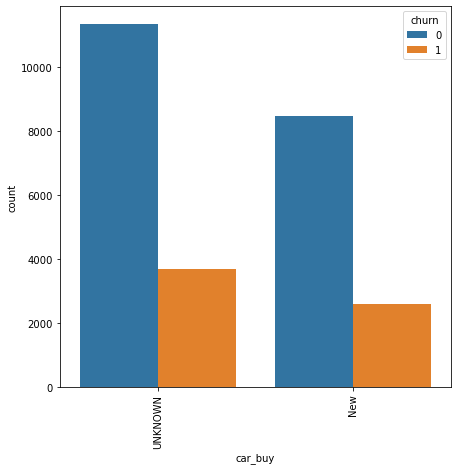

Top categories impacting churn
         churn
car_buy       
UNKNOWN  14999
New      11051
------------------------------------------------ Variable Name: children ------------------------------------------------
Unique Values:
['Y' nan 'N']


<Figure size 720x720 with 0 Axes>

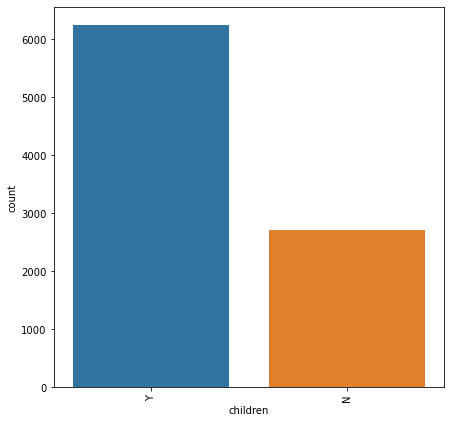

<Figure size 720x720 with 0 Axes>

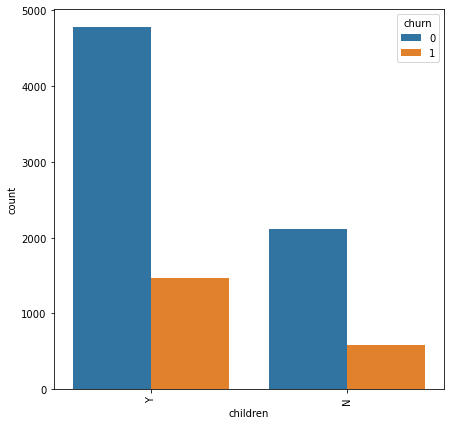

Top categories impacting churn
          churn
children       
Y          6251
N          2705
------------------------------------------------ Variable Name: csa ------------------------------------------------
Unique Values:
['AIRCOL803' 'LAXCUL310' 'STLSTL314' 'LAXANA714' 'NCRGRB757' 'ATLATL678'
 'APCFCH703' 'NYCNEW201' 'OKCOKC405' 'SLCOGD801' 'OMADES515' 'NYCMAN917'
 'APCSIL301' 'NYCNAS516' 'LAXLAX213' 'HARNEW203' 'NYCBRO917' 'NYCQUE917'
 'NYCWHI914' 'PHXTUC520' 'CHIDAV319' 'SEASEA206' 'INDIND317' 'OHISAN419'
 'MINMIN612' 'BOSNSH603' 'LAXCOV626' 'FLNKIS407' 'SFRCBL408' 'HARSPR413'
 'HOUHOU281' 'APCBAL410' 'DALDAL214' 'SFRSCL408' 'BOSMAN603' 'NORZIM763'
 'NCRNWN757' 'AWISHE920' 'NYCNEW908' 'HOUGLV409' 'MIAMIA305' 'OHICAN330'
 'AIRSPA864' 'NYCSUF516' 'LAXBUR818' 'LAXONT909' 'SANKIL254' 'DENBOU303'
 'SFRSFR415' 'SFRSRO707' 'NCRVIR757' 'ATLMEM901' 'HWIMAU808' 'DENGLD303'
 'DETROS810' 'BOSBOS617' 'PHIPHI215' 'DENDEN303' 'MIAWPB561' 'ATLNOR678'
 'MIAFTL954' 'DETDET313' 'HARBRI203' 'NEVES

<Figure size 720x720 with 0 Axes>

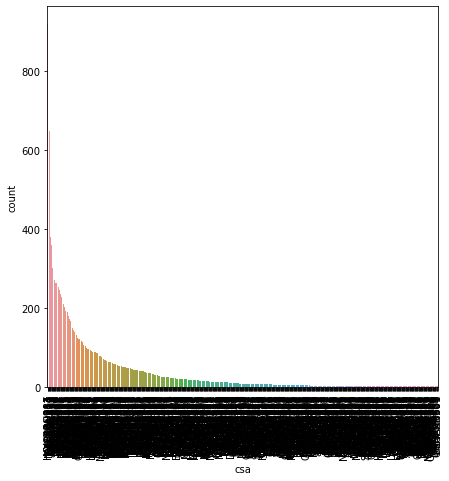

<Figure size 720x720 with 0 Axes>

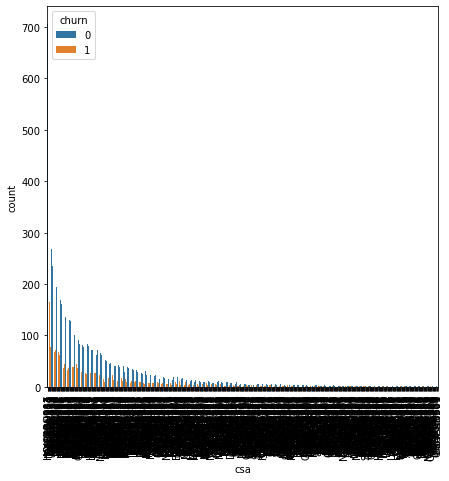

Top categories impacting churn
           churn
csa             
NYCBRO917    918
HOUHOU281    784
DALDAL214    762
NYCMAN917    649
APCFCH703    414
------------------------------------------------ Variable Name: div_type ------------------------------------------------
Unique Values:
[nan 'LDD' 'BTH' 'LTD']


<Figure size 720x720 with 0 Axes>

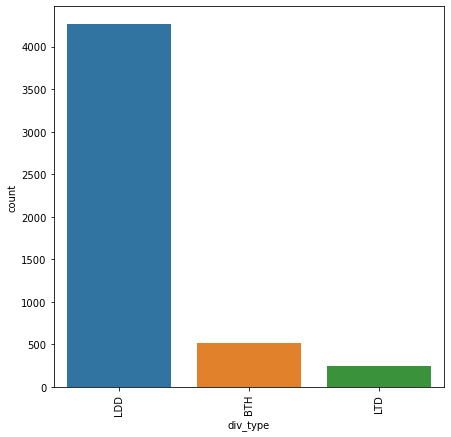

<Figure size 720x720 with 0 Axes>

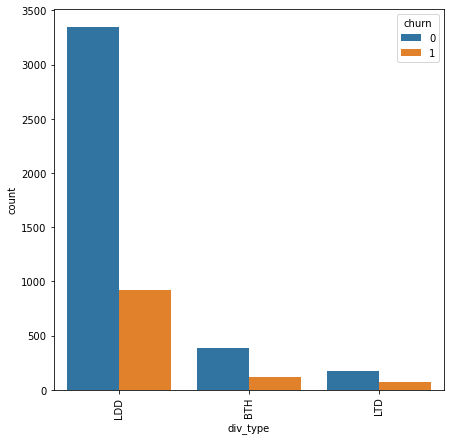

Top categories impacting churn
          churn
div_type       
LDD        4260
BTH         512
LTD         245


In [22]:
bivariate_analyze_cat(df,df_cat_temp,dep_var='churn')

### Correlation Heatmap

In [36]:
corr_df=df.corr()
df_lt = corr_df.where(np.tril(np.ones(corr_df.shape)).astype(np.bool))

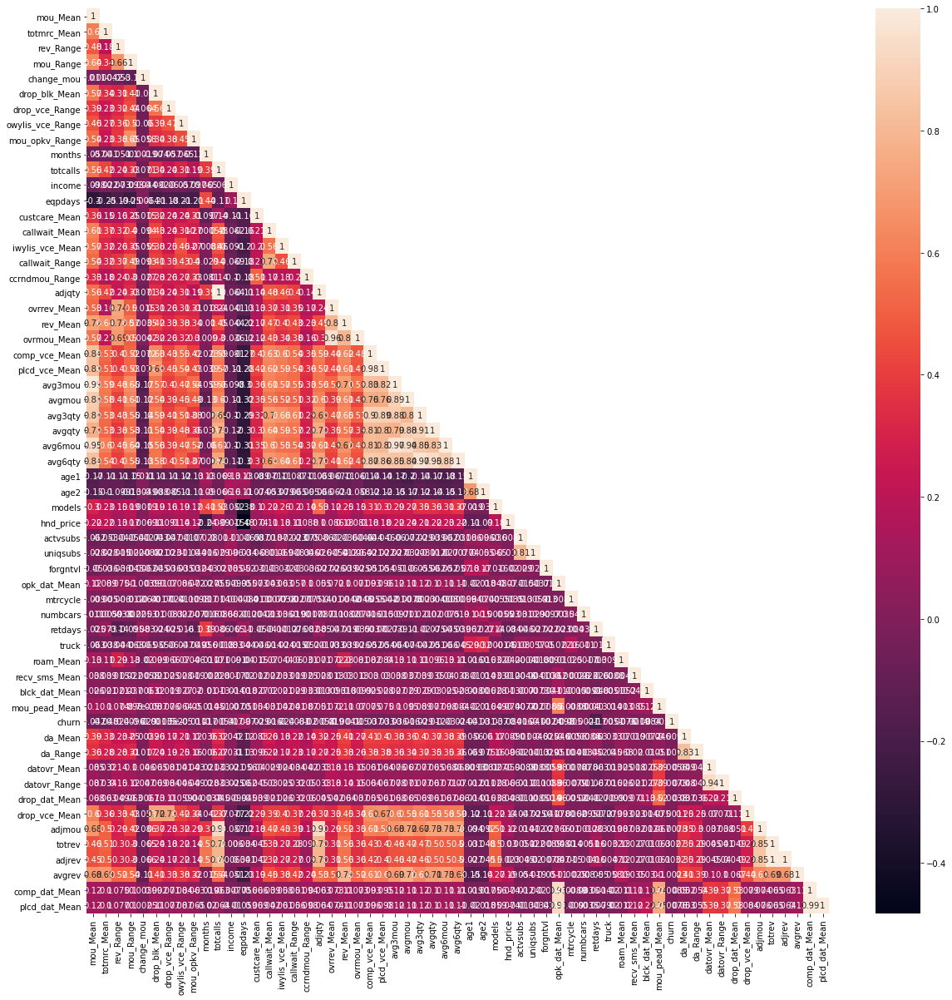

In [37]:
plt.figure(figsize=(20,20))
sns.heatmap(df_lt,annot=True,annot_kws={'size':10})

# Missing Value Treatment

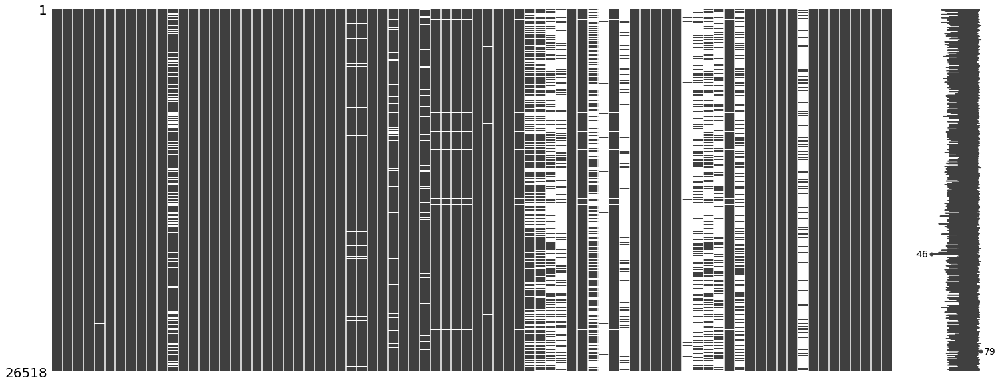

In [104]:
msno.matrix(df)

In [105]:
(df.isnull().sum()!=0).values.sum()

42

In [106]:
df.shape

(26518, 80)

In [107]:
round((((26518*81)-(26518*39))/(26518*81))*100,2)

51.85

## Drop Columns with more than 30% missing values

In [108]:
missing_df=pd.DataFrame(round(df.isna().sum().sort_values(ascending=False) / df.shape[0] * 100,2),columns=['Missing %'])
missing_df

,Missing %
solflag,98.06
retdays,96.73
wrkwoman,87.66
div_type,81.08
occu1,73.49
proptype,71.60
cartype,67.71
children,66.23
mailordr,64.15
mailresp,62.68


In [109]:
# Columns with more than 3% missing values
missing_df_3=missing_df[missing_df['Missing %'] > 3]
missing_df_3

,Missing %
solflag,98.06
retdays,96.73
wrkwoman,87.66
div_type,81.08
occu1,73.49
proptype,71.60
cartype,67.71
children,66.23
mailordr,64.15
mailresp,62.68


In [110]:
# Columns with more than 3% missing values
missing_df_30=missing_df[missing_df['Missing %'] > 30]
missing_df_30

,Missing %
solflag,98.06
retdays,96.73
wrkwoman,87.66
div_type,81.08
occu1,73.49
proptype,71.60
cartype,67.71
children,66.23
mailordr,64.15
mailresp,62.68


In [111]:
# Columns with more than 3% missing values
missing_df_3_30=missing_df[(missing_df['Missing %'] < 30) & (missing_df['Missing %'] > 3)]
missing_df_3_30

,Missing %
income,25.25
hnd_webcap,8.98
prizm_social_one,7.09
avg6qty,3.07
avg6mou,3.07


In [112]:
missing_df_30.shape

(13, 1)

In [113]:
df.drop(columns=missing_df_30.index,inplace=True)

In [114]:
df.shape

(26518, 67)

## Dropping rows using columns which have less than 3% missing values

In [115]:
missing_per_ID = round((df.isna().sum()/len(df))*100,2)

In [116]:
df_mr = pd.DataFrame(missing_per_ID).sort_values(by=0, ascending=False).head(50)

In [117]:
missing_value_rows = df_mr[df_mr[0]<3].index.tolist()
missing_value_rows

['marital',
 'ethnic',
 'age1',
 'age2',
 'forgntvl',
 'truck',
 'mtrcycle',
 'car_buy',
 'hnd_price',
 'change_mou',
 'roam_Mean',
 'da_Mean',
 'da_Range',
 'datovr_Mean',
 'ovrrev_Mean',
 'rev_Mean',
 'ovrmou_Mean',
 'datovr_Range',
 'mou_Range',
 'totmrc_Mean',
 'rev_Range',
 'mou_Mean',
 'csa',
 'area',
 'avgqty',
 'drop_vce_Range',
 'blck_dat_Mean',
 'mou_pead_Mean',
 'churn',
 'totcalls',
 'months',
 'mou_opkv_Range',
 'owylis_vce_Range',
 'drop_blk_Mean',
 'crclscod',
 'drop_dat_Mean',
 'drop_vce_Mean',
 'adjmou',
 'totrev',
 'adjrev',
 'avgrev',
 'comp_dat_Mean',
 'recv_sms_Mean',
 'eqpdays',
 'custcare_Mean']

In [118]:
df = df.dropna(subset= missing_value_rows)
df.shape

(25643, 67)

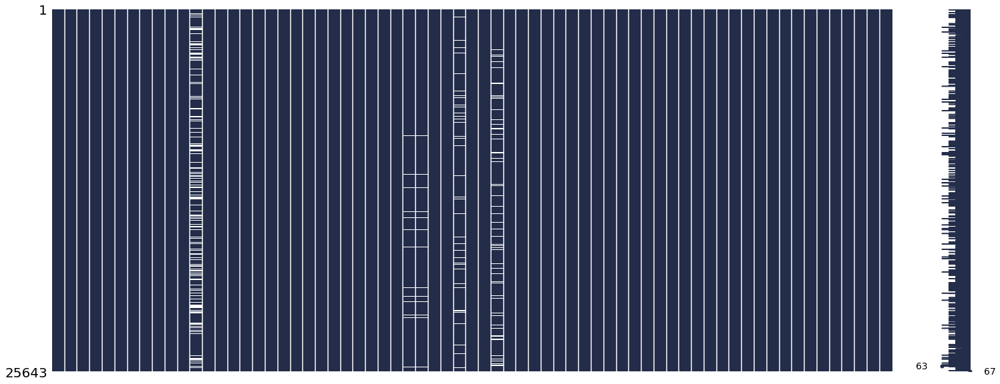

In [119]:
msno.matrix(df,color=(0.14,0.18,0.29))

## Treating columns with more than 3% and less than 30% missing values

In [120]:
missing_df_3_30

,Missing %
income,25.25
hnd_webcap,8.98
prizm_social_one,7.09
avg6qty,3.07
avg6mou,3.07


### cat cols

In [121]:
cat_cols=['income', 'crclscod', 'asl_flag', 'prizm_social_one', 'area', 'refurb_new', 'hnd_webcap', 'marital', 'ethnic', 
          'age1', 'age2', 'models', 'hnd_price', 'actvsubs', 'uniqsubs', 'forgntvl', 'dwlltype', 'dwllsize', 'mailordr', 
          'occu1', 'mtrcycle', 'numbcars', 'truck', 'wrkwoman', 'churn', 'solflag', 'proptype', 'mailresp', 'cartype',
          'car_buy', 'children', 'csa', 'div_type']

In [122]:
#Remaining cat cols with missing values
[x for x in cat_cols if x in missing_df_3_30.index]

['income', 'prizm_social_one', 'hnd_webcap']

In [123]:
df['income'].unique()

array([ 9.,  6.,  8.,  5., nan,  3.,  7.,  2.,  1.,  4.])

In [124]:
df['hnd_webcap'].unique()

array(['WCMB', 'WC', nan], dtype=object)

In [125]:
df['prizm_social_one'].unique()

array(['T', 'U', 'C', 'S', 'R', nan], dtype=object)

In [126]:
# Changing nan to MISSING for these two cols
df[['prizm_social_one','hnd_webcap']] = df[['prizm_social_one','hnd_webcap']].fillna("MISSING")

### New heading

In [127]:
df['prizm_social_one'].unique()

array(['T', 'U', 'C', 'S', 'R', 'MISSING'], dtype=object)

In [128]:
df['hnd_webcap'].unique()

array(['WCMB', 'WC', 'MISSING'], dtype=object)

In [129]:
#Changing nan to 0.0 for income col
df['income']=np.where(df['income'].isna(),0.0,df['income'])

In [130]:
df['income'].unique()

array([9., 6., 8., 5., 0., 3., 7., 2., 1., 4.])

### Cont cols

In [131]:
cont_cols=['mou_Mean', 'totmrc_Mean', 'rev_Range', 'mou_Range', 'change_mou', 'drop_blk_Mean', 'drop_vce_Range',
           'owylis_vce_Range', 'mou_opkv_Range', 'months', 'totcalls', 'eqpdays', 'custcare_Mean', 'callwait_Mean',
           'iwylis_vce_Mean', 'callwait_Range', 'ccrndmou_Range', 'adjqty', 'ovrrev_Mean', 'rev_Mean', 'ovrmou_Mean', 
           'comp_vce_Mean', 'plcd_vce_Mean', 'avg3mou', 'avgmou', 'avg3qty', 'avgqty', 'avg6mou', 'avg6qty', 'opk_dat_Mean',
           'retdays', 'roam_Mean', 'recv_sms_Mean', 'blck_dat_Mean', 'mou_pead_Mean', 'da_Mean', 'da_Range', 'datovr_Mean',
           'datovr_Range', 'drop_dat_Mean', 'drop_vce_Mean', 'adjmou', 'totrev', 'adjrev', 'avgrev', 'comp_dat_Mean',
           'plcd_dat_Mean']

In [132]:
#Remaining cont cols with missing values
[x for x in cont_cols if x in missing_df_3_30.index]

['avg6mou', 'avg6qty']

In [133]:
df['avg6mou'].interpolate(method='linear', inplace=True, limit_direction="both")
df['avg6qty'].interpolate(method='linear', inplace=True, limit_direction="both")

### No More missing values

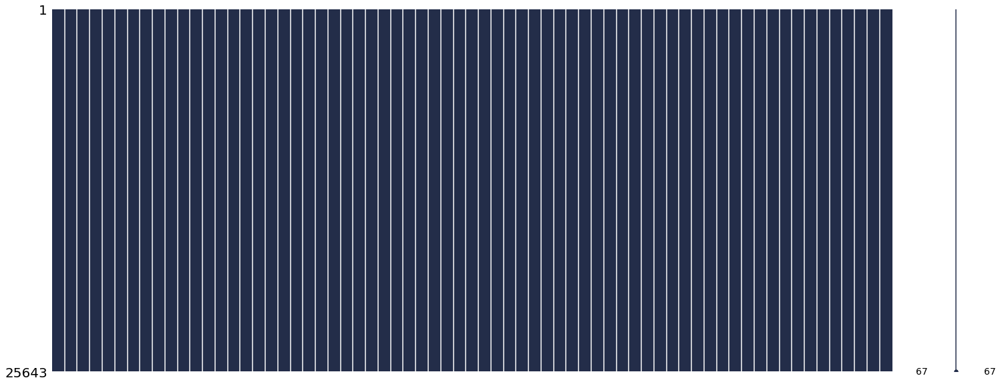

In [134]:
msno.matrix(df,color=(0.14,0.18,0.29))

In [135]:
df.isna().sum().sum()

0

## Making Cont and Cat DFs

In [136]:
len(cat_cols)

33

In [137]:
len(cont_cols)

47

In [138]:
cat_cols=[x for x in cat_cols if x not in missing_df_30.index]

In [139]:
len(cat_cols)

21

In [140]:
#cat_cols-missing_df_30.index
cont_cols=[x for x in cont_cols if x not in missing_df_30.index]

In [141]:
len(cont_cols)

46

In [142]:
#df[cat_cols] = df[cat_cols].astype('object')

In [143]:
df_cat=df[cat_cols]

In [144]:
df_cont=df[cont_cols]

In [145]:
df.shape

(25643, 67)

In [146]:
df_cat.shape

(25643, 21)

In [147]:
df_cont.shape

(25643, 46)

# Outlier Analysis

In [148]:
df_before_outlier = df.copy()
df_before_outlier.shape

(25643, 67)

In [149]:
outlier_dict={}
for col in df_cont:
    outlier_list=[]
    q1,q3=np.nanpercentile(df_cont[col],[25,75])
    q1,q3
    iqr=q3-q1
    iqr
    lower=q1-(1.5*iqr)
    upper=q3+(1.5*iqr)
    upper,lower
    for i in df[col]:
        if i < lower or i > upper:
            outlier_list.append(i)
    #print(color.BOLD + color.RED + "Variable: {}".format(col) +color.END)
    #print("Outliers: {}".format(np.sort(outlier_list)))
    #print("Outlier Count: {}".format(len(outlier_list)))
    outlier_dict.update({col:len(outlier_list)})
outlier_cont_df=pd.DataFrame(data=outlier_dict,index=['Outlier Count']).T.sort_values(by='Outlier Count',ascending=False)
outlier_cont_df['Percent Outlier']=outlier_cont_df['Outlier Count']/df.shape[0]*100
outlier_cont_df

,Outlier Count,Percent Outlier
roam_Mean,4705,18.348087
plcd_dat_Mean,3990,15.559802
callwait_Mean,3831,14.939750
datovr_Mean,3595,14.019421
datovr_Range,3594,14.015521
change_mou,3557,13.871232
comp_dat_Mean,3556,13.867332
custcare_Mean,3461,13.496861
ccrndmou_Range,3244,12.650626
ovrmou_Mean,2983,11.632804


In [150]:
z = np.abs(stats.zscore(df_cont))

In [151]:
df_cont_zscore = df_cont[(z < 4).all(axis=1)]

In [152]:
df_cont.shape

(25643, 46)

In [153]:
df_cont_zscore.shape

(22728, 46)

In [158]:
df_cont[col]

Customer_ID
1064525    0.000000
1048538    0.333333
1010139    0.333333
1014496    0.000000
1012053    0.000000
             ...   
1048705    0.000000
1026617    0.000000
1085271    0.000000
1050542    0.000000
1021809    0.000000
Name: plcd_dat_Mean, Length: 25643, dtype: float64

In [159]:
df_cont_zscore[col]

Customer_ID
1064525    0.000000
1048538    0.333333
1010139    0.333333
1014496    0.000000
1012053    0.000000
             ...   
1073526    0.000000
1026617    0.000000
1085271    0.000000
1050542    0.000000
1021809    0.000000
Name: plcd_dat_Mean, Length: 22728, dtype: float64

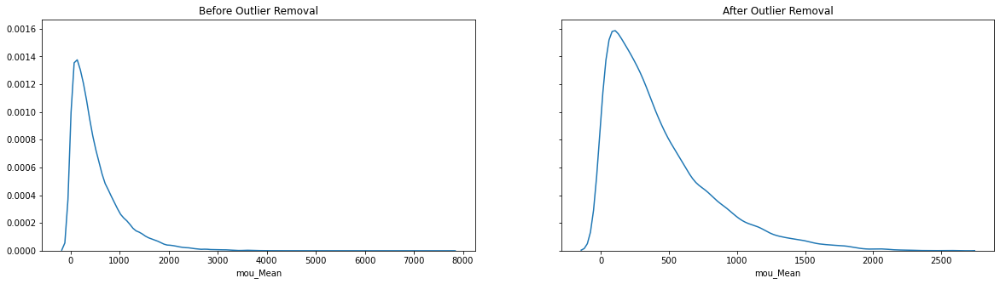

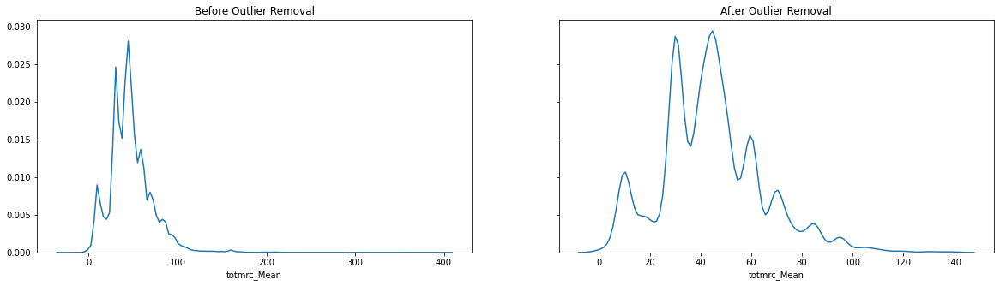

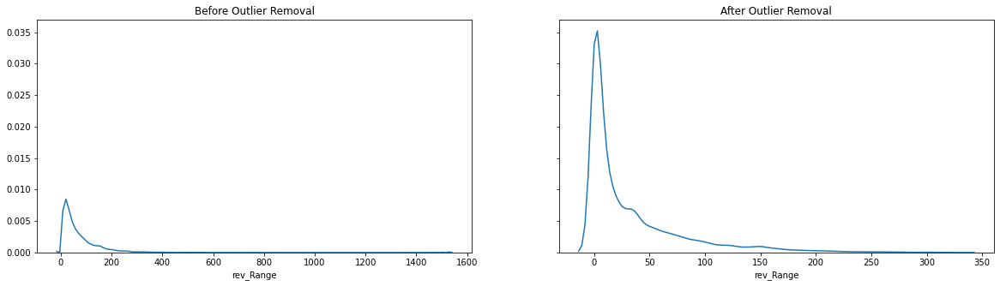

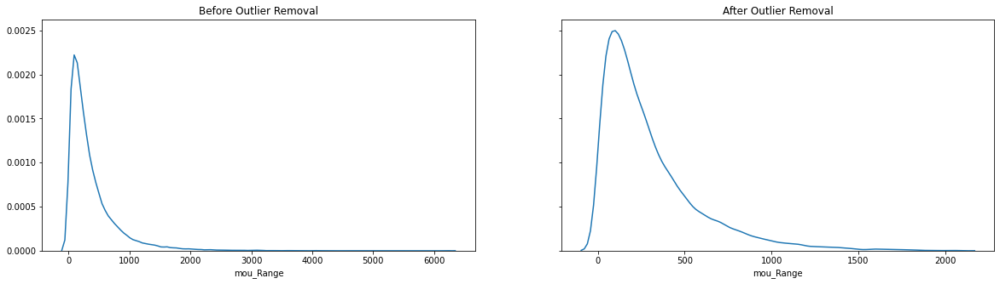

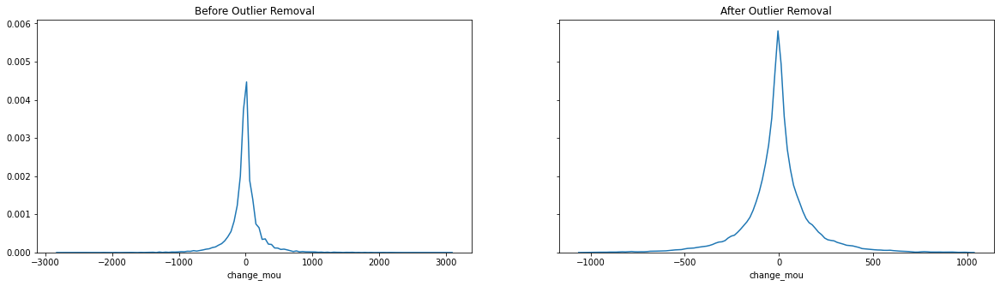

...

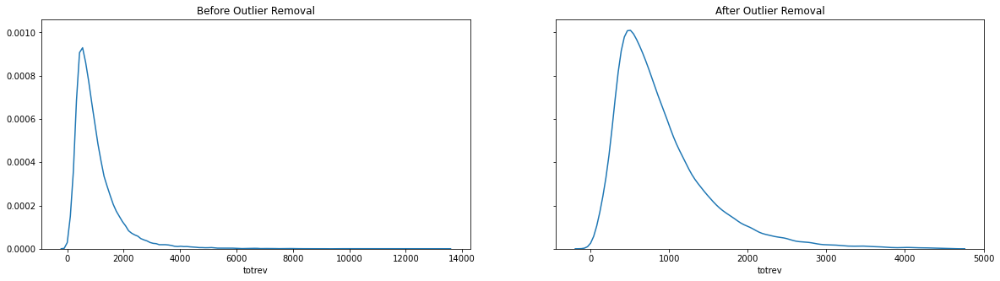

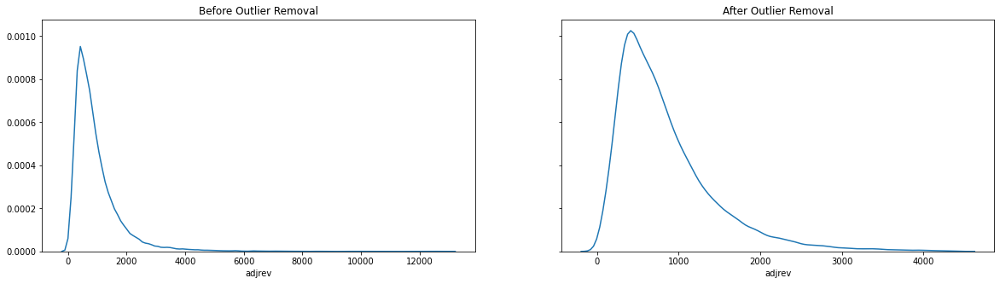

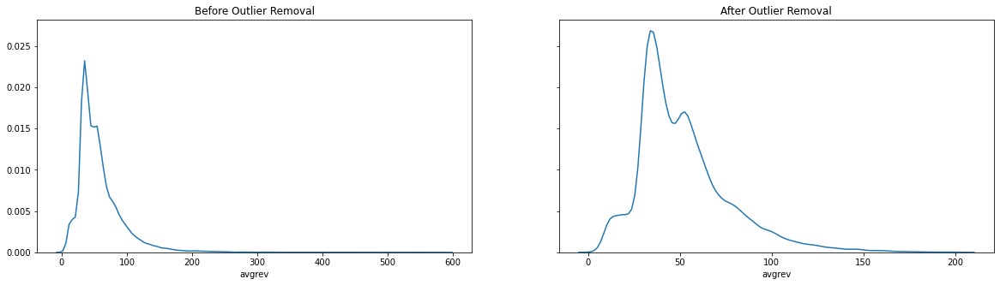

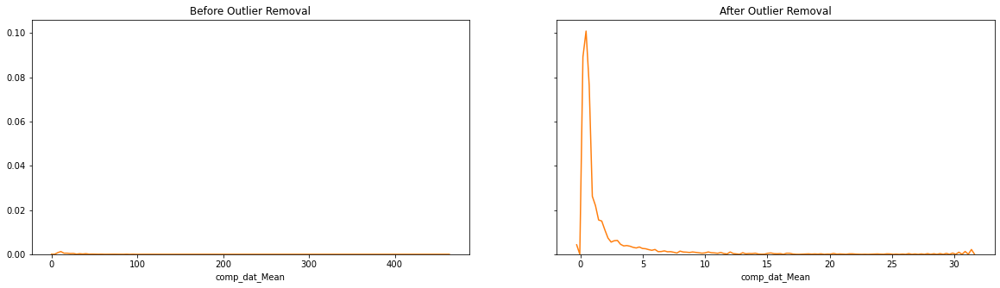

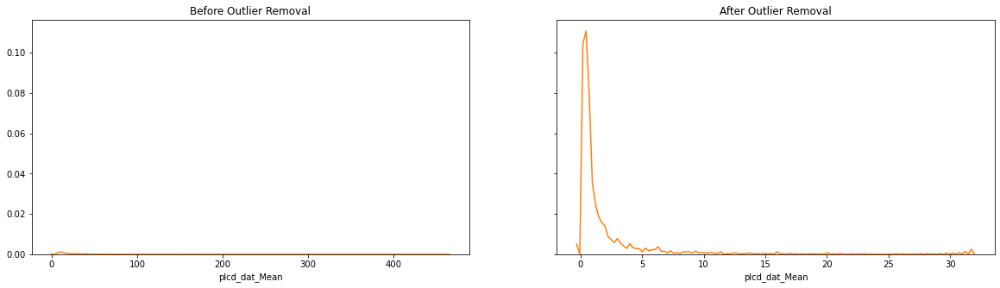

In [165]:
for i, col in enumerate(df_cont_zscore.columns):
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(20,5),sharey=True)
    ax1.set_title('Before Outlier Removal') 
    ax2.set_title('After Outlier Removal')
    try:
        sns.distplot(df_cont[col], hist=False,ax=ax1)
    except RuntimeError as re:
        if str(re).startswith("Selected KDE bandwidth is 0. Cannot estiamte density."):
            sns.distplot(df_cont[col],kde_kws={'bw': 0.1}, hist=False,ax=ax1)
        else:
            raise re
    try:
        sns.distplot(df_cont_zscore[col], hist=False,ax=ax2)
    except RuntimeError as re:
        if str(re).startswith("Selected KDE bandwidth is 0. Cannot estiamte density."):
            sns.distplot(df_cont_zscore[col],kde_kws={'bw': 0.1}, hist=False,ax=ax2)
                
        else:
            raise re

# New heading

In [166]:
df_cont_zscore.shape

(22728, 46)

In [167]:
df_cont_zscore.head()

,mou_Mean,totmrc_Mean,rev_Range,mou_Range,change_mou,drop_blk_Mean,drop_vce_Range,owylis_vce_Range,mou_opkv_Range,months,totcalls,eqpdays,custcare_Mean,callwait_Mean,iwylis_vce_Mean,callwait_Range,ccrndmou_Range,adjqty,ovrrev_Mean,rev_Mean,ovrmou_Mean,comp_vce_Mean,plcd_vce_Mean,avg3mou,avgmou,avg3qty,avgqty,avg6mou,avg6qty,opk_dat_Mean,roam_Mean,recv_sms_Mean,blck_dat_Mean,mou_pead_Mean,da_Mean,da_Range,datovr_Mean,datovr_Range,drop_dat_Mean,drop_vce_Mean,adjmou,totrev,adjrev,avgrev,comp_dat_Mean,plcd_dat_Mean
Customer_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1064525,190.25,63.9400,26.00,43.0,-11.25,4.666667,8,20,28.44,14,1104,403,0.000000,0.666667,10.333333,2,0,1104,2.050,53.4900,5.50,59.333333,73.333333,194,182.77,91,84.92,211.0,99.0,0.0,0.0,0.0,0.0,0.000000,0.0000,0.00,0.0000,0.00,0.0,3.666667,2376.0,519.07,489.08,37.62,0.000000,0.000000
1048538,443.00,39.9900,5.10,199.0,-78.00,4.333333,5,33,72.46,13,2237,404,1.333333,0.000000,16.333333,0,14,2230,8.840,34.3575,25.00,87.000000,104.333333,469,463.75,188,185.83,467.0,166.0,0.0,0.0,0.0,0.0,0.883333,0.2475,0.99,0.8775,3.51,0.0,3.000000,5565.0,598.53,538.55,44.88,0.333333,0.333333
1010139,400.50,44.9900,13.88,172.0,-67.50,2.000000,1,7,93.60,29,3276,213,1.000000,0.000000,0.000000,0,28,3269,4.725,40.5350,13.50,124.666667,153.000000,423,291.33,134,121.07,333.0,118.0,0.0,0.0,0.0,0.0,0.000000,0.4950,1.98,0.0000,0.00,0.0,0.333333,7866.0,1616.71,1586.36,58.75,0.000000,0.333333
1014496,53.50,34.6675,18.56,78.0,12.50,1.333333,2,0,4.70,25,1932,757,4.666667,0.000000,0.000000,0,76,1924,9.300,38.7400,23.25,32.333333,43.000000,49,243.50,25,80.17,244.0,95.0,0.0,0.0,0.0,0.0,0.000000,0.0000,0.00,0.0000,0.00,0.0,0.666667,5844.0,1682.44,1647.63,68.65,0.000000,0.000000
1012053,37.00,21.0425,35.79,74.0,-33.00,5.666667,1,4,36.60,33,652,983,0.333333,0.000000,0.000000,0,4,636,0.000,21.0425,0.00,10.666667,18.000000,48,50.74,12,20.52,43.0,16.0,0.0,0.0,0.0,0.0,0.000000,0.0000,0.00,0.0000,0.00,0.0,1.333333,1573.0,967.59,916.61,29.57,0.000000,0.000000


In [168]:
df_cat.shape

(25643, 21)

In [169]:
df_cont=df_cont_zscore.copy()

In [170]:
df=pd.concat([df_cont,df_cat],axis=1).dropna()

In [171]:
df.shape

(22728, 67)

In [172]:
df_org.shape

(26518, 81)

In [173]:
# Percent of rows dropped
100 - ((df.shape[0]*100)/df_org.shape[0])

14.292178897352741

In [174]:
# Number of rows dropped
df_org.shape[0]-df.shape[0]

3790

# Convert cat cols to Nominal, Ordinal & Boolean

In [175]:
df_cat.columns

Index(['income', 'crclscod', 'asl_flag', 'prizm_social_one', 'area',
       'refurb_new', 'hnd_webcap', 'marital', 'ethnic', 'age1', 'age2',
       'models', 'hnd_price', 'actvsubs', 'uniqsubs', 'forgntvl', 'mtrcycle',
       'truck', 'churn', 'car_buy', 'csa'],
      dtype='object')

In [176]:
for col in df_cat:
    print("--------------------------"+str(col)+"--------------------------")
    print("unique Values :" ,df[col].unique()) # to print categories name only
    print("Value counts of unique values :\n",df[col].value_counts()) # to print count of every category
    print("-----------------------------------------------------------------------------------------")

--------------------------income--------------------------
unique Values : [9. 3. 6. 0. 8. 7. 5. 4. 1. 2.]
Value counts of unique values :
 0.0    5259
6.0    4455
7.0    2653
9.0    2604
5.0    1920
4.0    1845
3.0    1360
8.0    1223
1.0     860
2.0     549
Name: income, dtype: int64
-----------------------------------------------------------------------------------------
--------------------------crclscod--------------------------
unique Values : ['A' 'B' 'C' 'AA' 'D' 'U' 'BA' 'CA' 'DA' 'EA' 'W' 'Z' 'G' 'H' 'K' 'O' 'E'
 'E4' 'J' 'GA' 'A2' 'Y' 'U1' 'M' 'ZA' 'D4' 'CC' 'I' 'C5' 'C2' 'E2' 'Z4'
 'V1' 'B2' 'EM' 'TP' 'Z1' 'CY' 'D2' 'Z5' 'A3' 'D5' 'JF' 'GY' 'EC' 'EF'
 'ZY']
Value counts of unique values :
 AA    8810
A     3824
BA    2791
CA    1908
EA    1459
B      867
DA     787
ZA     737
C      345
E4     161
A2     159
U       87
D4      72
E       70
D       67
GA      65
JF      52
G       47
Z4      42
Z       42
CY      39
C2      36
M       33
D5      28
I       25
ZY      24
C5 

In [177]:
# To be One Hot Encoded
cat_nominal=['crclscod','prizm_social_one','area','hnd_webcap','marital','ethnic','csa']
df_cat_nominal=df_cat[cat_nominal]
df_cat_nominal.head()

,crclscod,prizm_social_one,area,hnd_webcap,marital,ethnic,csa
Customer_ID,,,,,,,
1064525,AA,T,ATLANTIC SOUTH AREA,WCMB,M,N,AIRCOL803
1048538,EA,U,LOS ANGELES AREA,WCMB,U,S,LAXCUL310
1010139,C,C,MIDWEST AREA,WCMB,M,N,STLSTL314
1014496,EA,U,LOS ANGELES AREA,WC,U,U,LAXANA714
1012053,G,U,DC/MARYLAND/VIRGINIA AREA,MISSING,B,N,NCRGRB757


In [178]:
# To be label encoded
cat_ordinal=['income','age1','age2','models','hnd_price','actvsubs','uniqsubs']
df_cat_ordinal=df_cat[cat_ordinal]
df_cat_ordinal.head()

,income,age1,age2,models,hnd_price,actvsubs,uniqsubs
Customer_ID,,,,,,,
1064525,9.0,36.0,0.0,1,199.98999,2,2
1048538,9.0,0.0,0.0,1,149.98999,1,1
1010139,6.0,32.0,30.0,2,99.98999,1,1
1014496,8.0,34.0,38.0,1,29.98999,1,1
1012053,5.0,78.0,0.0,1,29.98999,1,1


In [179]:
# To be label encoded
cat_boolean=['asl_flag','refurb_new','forgntvl','mtrcycle','truck','churn','car_buy']
df_cat_boolean=df_cat[cat_boolean]
df_cat_boolean.head()

,asl_flag,refurb_new,forgntvl,mtrcycle,truck,churn,car_buy
Customer_ID,,,,,,,
1064525,N,N,0.0,0.0,0.0,0,UNKNOWN
1048538,N,N,0.0,0.0,0.0,0,New
1010139,N,N,0.0,0.0,0.0,0,New
1014496,N,N,0.0,0.0,0.0,0,New
1012053,N,N,0.0,0.0,0.0,0,UNKNOWN


## Bucketing a few columns before encoding

### crclscod

In [180]:
df['crclscod'].value_counts().head(11).index

Index(['AA', 'A', 'BA', 'CA', 'EA', 'B', 'DA', 'ZA', 'C', 'E4', 'A2'], dtype='object')

In [181]:
df_backup=df.copy()

In [182]:
df['crclscod']=np.where(np.logical_not(df['crclscod'].isin(df['crclscod'].value_counts().head(11).index)),'OTHERS',
                        df['crclscod'])

In [183]:
df['crclscod'].value_counts()

AA        8810
A         3824
BA        2791
CA        1908
EA        1459
OTHERS     880
B          867
DA         787
ZA         737
C          345
E4         161
A2         159
Name: crclscod, dtype: int64

### ethnic 

In [184]:
(df['ethnic'].value_counts()>500).sum()

10

In [185]:
df['ethnic'].value_counts().head((df['ethnic'].value_counts()>500).sum()).index

Index(['N', 'S', 'H', 'U', 'G', 'Z', 'O', 'I', 'J', 'F'], dtype='object')

In [186]:
df['ethnic'].value_counts()

N    7909
S    3015
H    2913
U    2574
G    1424
Z    1044
O     900
I     861
J     637
F     510
B     300
R     213
D     195
P     124
C      54
M      30
X      25
Name: ethnic, dtype: int64

In [187]:
df['ethnic']=np.where(np.logical_not(df['ethnic'].isin(df['ethnic'].value_counts().head((
    df['ethnic'].value_counts()>500).sum()).index)),'OTHERS',df['ethnic'])

In [188]:
df['ethnic'].value_counts()

N         7909
S         3015
H         2913
U         2574
G         1424
Z         1044
OTHERS     941
O          900
I          861
J          637
F          510
Name: ethnic, dtype: int64

### csa

In [189]:
len(df['csa'].unique())

679

In [190]:
df['csa'].value_counts().head((df['csa'].value_counts()>100).sum()).index

Index(['NYCBRO917', 'HOUHOU281', 'DALDAL214', 'NYCMAN917', 'APCFCH703',
       'DALFTW817', 'APCSIL301', 'SANSAN210', 'SANAUS512', 'SFRSFR415',
       'OHICOL614', 'ATLATL678', 'NYCQUE917', 'STLSTL314', 'SFROAK510',
       'ATLANE678', 'BOSBOS617', 'SFRSCL408', 'NEVLVS702', 'MINMIN612',
       'KCYKCM816', 'CHINBK847', 'SANMCA210', 'PHXPHX602', 'APCBAL410',
       'NYCNEW201', 'MIAMIA305', 'INDIND317', 'NYCNAS516', 'KCYKCK913',
       'LAXANA714', 'DENDEN303', 'CHICHI773', 'DETDET313', 'PHIPHI215',
       'NSHNSH615', 'NEVSDG619', 'APCWAS202', 'NYCSUF516', 'MILMIL414',
       'DETPON248', 'NOLKEN504', 'SEASEA206', 'NYCWHI914', 'NNYBUF716',
       'FLNORL407', 'OHICIN513', 'HARHAR860', 'NYCNEW973', 'CHILAG630',
       'BOSMAN603', 'FLNTAM813', 'OMAOMA402', 'MIAFTL954', 'MINSTP612',
       'SFRSMO650', 'HWIHON808', 'LOULOU502', 'FLNCLR813', 'LAXSAN714'],
      dtype='object')

In [191]:
len(df['csa'].value_counts().head((df['csa'].value_counts()>100).sum()).index)

60

In [192]:
df['csa']=np.where(np.logical_not(df['csa'].isin(df['csa'].value_counts().head((df['csa'].value_counts()>100).sum()).index)),
                      'OTHERS',
                        df['csa'])

In [193]:
len(df['csa'].unique())

61

In [194]:
df['csa'].value_counts()

OTHERS       10096
NYCBRO917      759
HOUHOU281      684
DALDAL214      658
NYCMAN917      536
APCFCH703      361
DALFTW817      327
APCSIL301      317
SANSAN210      302
SANAUS512      290
SFRSFR415      251
OHICOL614      238
ATLATL678      236
NYCQUE917      235
STLSTL314      232
SFROAK510      230
ATLANE678      229
BOSBOS617      226
SFRSCL408      223
NEVLVS702      214
MINMIN612      213
CHINBK847      211
KCYKCM816      211
PHXPHX602      204
SANMCA210      204
APCBAL410      199
MIAMIA305      190
NYCNEW201      190
INDIND317      174
NYCNAS516      171
DENDEN303      170
KCYKCK913      170
LAXANA714      170
CHICHI773      164
DETDET313      161
PHIPHI215      160
NSHNSH615      159
NEVSDG619      154
APCWAS202      154
NYCSUF516      146
MILMIL414      144
DETPON248      140
NOLKEN504      138
SEASEA206      132
NYCWHI914      128
NNYBUF716      128
FLNORL407      127
OHICIN513      124
HARHAR860      123
NYCNEW973      122
CHILAG630      121
BOSMAN603      117
FLNTAM813   

### actvsubs 

In [195]:
df['actvsubs'].value_counts()

1     16047
2      5586
3       834
4       175
5        60
0        21
6         4
11        1
Name: actvsubs, dtype: int64

In [196]:
df['actvsubs']=np.where(df['actvsubs']>4,5,df['actvsubs'])

In [197]:
df['actvsubs'].dtype

dtype('int64')

In [198]:
df['actvsubs'].value_counts()

1    16047
2     5586
3      834
4      175
5       65
0       21
Name: actvsubs, dtype: int64

In [199]:
df['actvsubs'].dtype

dtype('int64')

### uniqsubs

In [200]:
df['uniqsubs'].value_counts()

1     14248
2      6295
3      1395
4       543
5       168
6        54
7        17
9         3
8         3
12        1
11        1
Name: uniqsubs, dtype: int64

In [201]:
df['uniqsubs']=np.where(df['uniqsubs']>5,6,df['uniqsubs'])

In [202]:
df['uniqsubs'].dtype

dtype('int64')

In [204]:
df['uniqsubs'].value_counts()

1    14248
2     6295
3     1395
4      543
5      168
6       79
Name: uniqsubs, dtype: int64

# Encoding categorical variables

In [205]:
df.shape

(22728, 67)

In [206]:
df_linear=df.copy()
df_tree=df.copy()

## Label Encoding - Ordinal and Boolean  cat variables

In [207]:
labelencoder=LabelEncoder()
for col in df_cat_boolean:
    if col == 'churn':
        continue
    else:
        df_linear[col]=labelencoder.fit_transform(df_linear[col])
        df_tree[col]=labelencoder.fit_transform(df_tree[col])
        df_cat_boolean[col]=labelencoder.fit_transform(df_cat_boolean[col])

In [208]:
labelencoder=LabelEncoder()
for col in df_cat_ordinal:
        df_linear[col]=labelencoder.fit_transform(df_linear[col])
        df_tree[col]=labelencoder.fit_transform(df_tree[col])
        df_cat_ordinal[col]=labelencoder.fit_transform(df_cat_ordinal[col])

## OneHot Encoding - Nominal cat variables

In [209]:
# For linear model we will do OneHot
for col in df_cat_nominal:
        dummy_df=pd.get_dummies(df_linear[col],prefix=str(col)+"_")
        df_linear = df_linear.join(dummy_df)
        df_linear.drop(col,axis=1,inplace=True)

In [210]:
labelencoder=LabelEncoder()
for col in df_cat_nominal:
        df_tree[col]=labelencoder.fit_transform(df_tree[col])

In [211]:
df.shape

(22728, 67)

In [212]:
df_tree.shape

(22728, 67)

In [213]:
df_linear.shape

(22728, 177)

In [108]:
df_tree.to_csv('Cleaned_Data_Tree.csv')
df_linear.to_csv('Cleaned_Data_Linear.csv')